In [1]:
%load_ext autoreload
%autoreload 2

import cv2
import seaborn as sns
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
import plotly.express as px
import glob
import h5py

import sys
sys.path.append('../../../../src')
from utils import smooth_curve
from viz import show_images
from PlumeDataset import plume_dataset
from AutoAlign import align_plumes
from Velocity import VelocityCalculator
from PlumeMetrics import PlumeMetrics
from HorizontalLineProfileAnalyzer import HorizontalLineProfileAnalyzer
from AutoAlign import visualize_corners
from analyze_function import analyze_function

## add growth condition

In [61]:
df_condition = []
for file in glob.glob('../../../../datasets/SRO_plume_metrics/SRO_condition_mapping_metrics-P*.csv'):
    growth = file.split('-')[-1][:-4]
    pressure = float(growth.split('_')[0][1:])
    fluence = float(growth.split('_')[-1][1:])
    # print(file, growth, pressure, fluence)
    df = pd.DataFrame([{'Growth': growth, 'Pressure (mTorr)': pressure, 'Temperature (C)':700, 
                        'Fluence (J/cm2)': fluence, 'Repetation rate (Hz)': 5}])    
    df_condition.append(df)
df_condition = pd.concat(df_condition, ignore_index=True)
df_condition

,Growth,Pressure (mTorr),Temperature (C),Fluence (J/cm2),Repetation rate (Hz)
0,P100_F0.8,100.0,700,0.8,5
1,P100_F1.2,100.0,700,1.2,5
2,P100_F1.6,100.0,700,1.6,5
3,P100_F2.2,100.0,700,2.2,5
4,P100_F2,100.0,700,2.0,5
5,P125_F0.8,125.0,700,0.8,5
6,P125_F1.2,125.0,700,1.2,5
7,P125_F1.6,125.0,700,1.6,5
8,P125_F2.2,125.0,700,2.2,5
9,P125_F2,125.0,700,2.0,5


In [64]:
df = pd.read_csv('../../../../datasets/SRO_plume_metrics/SRO_condition_mapping_metrics-all.csv')
df.drop(columns=['Unnamed: 0'], inplace=True)
df.sample(5)

,plume_index,time_index,Distance,Velocity,Area,Threshold,Growth,Pressure (mTorr),Fluence (J/cm2)
89041,11,81,244,0.0,0.0,200,P50_F2,50,2.0
50752,0,64,244,0.0,112.0,5,P200_F1.6,200,1.6
4875,2,11,269,0.0,33290.0,5,P100_F1.6,100,1.6
71627,1,75,254,0.0,0.0,200,P50_F2.2,50,2.2
32761,3,121,281,0.0,22.0,5,P150_F2,150,2.0


In [66]:
merged_df = pd.merge(df, df_condition, on='Growth', how='left')
merged_df

,plume_index,time_index,Distance,Velocity,Area,Threshold,Growth,Pressure (mTorr)_x,Fluence (J/cm2)_x,Pressure (mTorr)_y,Temperature (C),Fluence (J/cm2)_y,Repetation rate (Hz)
0,0,0,0,0.0,0.0,5,P100_F0.8,100,0.8,100.0,700,0.8,5
1,0,1,0,0.0,0.0,5,P100_F0.8,100,0.8,100.0,700,0.8,5
2,0,2,157,314000000.0,17271.0,5,P100_F0.8,100,0.8,100.0,700,0.8,5
3,0,3,157,0.0,3275.0,5,P100_F0.8,100,0.8,100.0,700,0.8,5
4,0,4,157,0.0,5872.0,5,P100_F0.8,100,0.8,100.0,700,0.8,5
...,...,...,...,...,...,...,...,...,...,...,...,...,...
113659,5,123,250,0.0,78.0,flexible,P75_F2,75,2.0,75.0,700,2.0,5
113660,5,124,250,0.0,0.0,flexible,P75_F2,75,2.0,75.0,700,2.0,5
113661,5,125,250,0.0,89.0,flexible,P75_F2,75,2.0,75.0,700,2.0,5
113662,5,126,250,0.0,80.0,flexible,P75_F2,75,2.0,75.0,700,2.0,5


## analyze the plumes

In [2]:
for file in glob.glob('D:/pld_plumes/SRO_STO_Drexel/SRO_Mapping/*.h5'):
    print(file) 
    plume_ds = plume_dataset(file_path=file, group_name='PLD_Plumes')
    keys = plume_ds.dataset_names()
    print(keys)

D:/pld_plumes/SRO_STO_Drexel/SRO_Mapping\SRO_Plume_Mapping_100mTorr_YichenGuo_08042024.h5
['1-SrRuO3-2.2', '2-SrRuO3-2', '3-SrRuO3-1.6', '4-SrRuO3-1.2', '5-SrRuO3-0.8']
D:/pld_plumes/SRO_STO_Drexel/SRO_Mapping\SRO_Plume_Mapping_125mTorr_YichenGuo_08042024.h5
['1-SrRuO3-2.2', '2-SrRuO3-2', '3-SrRuO3-1.6', '4-SrRuO3-1.2', '5-SrRuO3-0.8']
D:/pld_plumes/SRO_STO_Drexel/SRO_Mapping\SRO_Plume_Mapping_150mTorr_YichenGuo_08042024.h5
['1-SrRuO3-2.2', '2-SrRuO3-2', '3-SrRuO3-1.6', '4-SrRuO3-1.2', '5-SrRuO3-0.8']
D:/pld_plumes/SRO_STO_Drexel/SRO_Mapping\SRO_Plume_Mapping_175mTorr_YichenGuo_08042024.h5
['1-SrRuO3-2.2', '2-SrRuO3-2', '3-SrRuO3-1.6', '4-SrRuO3-1.2', '5-SrRuO3-0.8']
D:/pld_plumes/SRO_STO_Drexel/SRO_Mapping\SRO_Plume_Mapping_200mTorr_YichenGuo_08042024.h5
['1-SrRuO3-2.2', '2-SrRuO3-2', '3-SrRuO3-1.6', '4-SrRuO3-1.2', '5-SrRuO3-0.8']
D:/pld_plumes/SRO_STO_Drexel/SRO_Mapping\SRO_Plume_Mapping_50mTorr_YichenGuo_08042024.h5
['1-SrRuO3-2.2', '1-SrRuO3_Pre', '2-SrRuO3-2', '3-SrRuO3-1.6', '4-

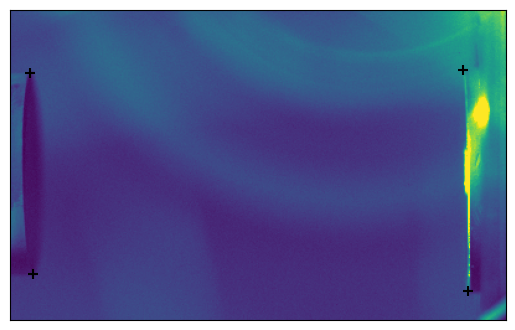

In [3]:
file = 'D:/pld_plumes/SRO_STO_Drexel/SRO_Mapping\SRO_Plume_Mapping_50mTorr_YichenGuo_08042024.h5'
plume_ds = plume_dataset(file_path=file, group_name='PLD_Plumes')
# ds_name = file.split('/')[-1].split('_')[0]
frame_view = plume_ds.load_plumes('1-SrRuO3_Pre')[1][1]
coords = np.array([[16,50], [18,212], [365,48], [369,226]])
# px.imshow(frame_view_YG063)
visualize_corners(frame_view, coords, color='k', marker_size=50)

D:/pld_plumes/SRO_STO_Drexel/SRO_Mapping\SRO_Plume_Mapping_100mTorr_YichenGuo_08042024.h5 100 2.2


100%|██████████| 6/6 [00:02<00:00,  2.18it/s]


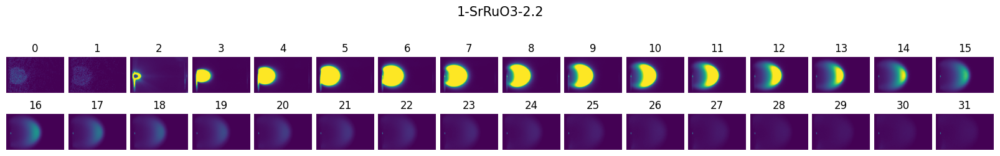

100%|██████████| 6/6 [00:00<00:00,  7.29it/s]


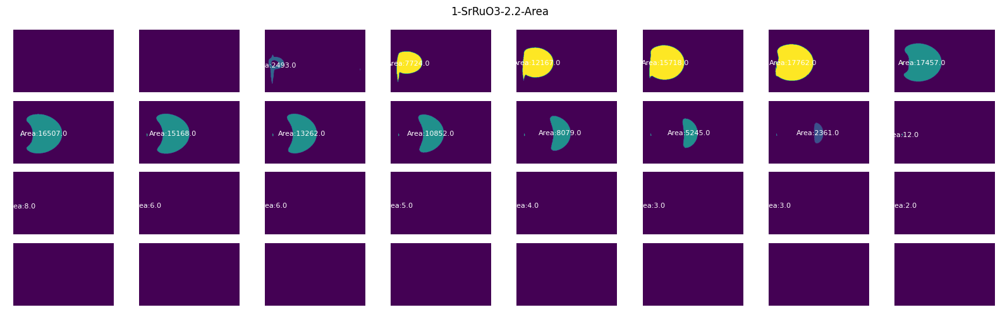

100%|██████████| 6/6 [00:00<00:00, 14.67it/s]


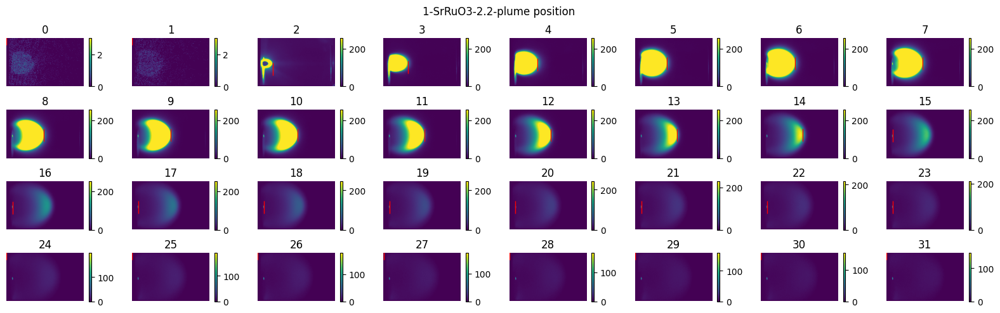

D:/pld_plumes/SRO_STO_Drexel/SRO_Mapping\SRO_Plume_Mapping_100mTorr_YichenGuo_08042024.h5 100 2


100%|██████████| 6/6 [00:02<00:00,  2.12it/s]


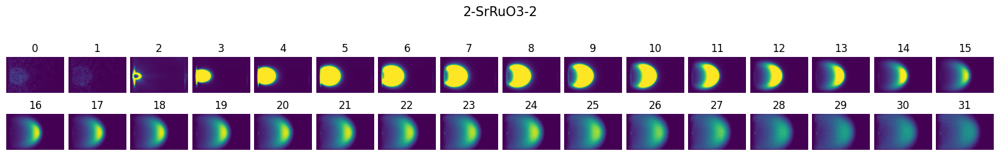

100%|██████████| 6/6 [00:00<00:00,  7.30it/s]


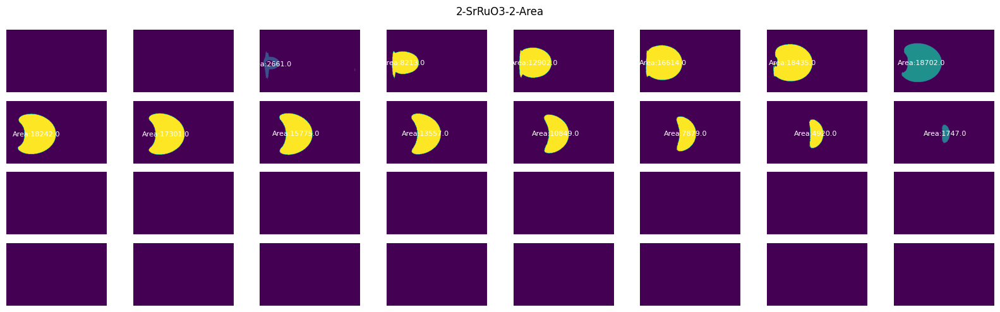

100%|██████████| 6/6 [00:00<00:00,  7.69it/s]


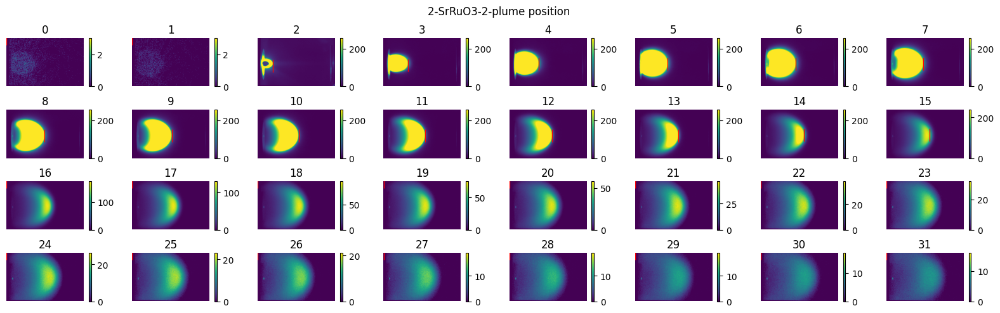

D:/pld_plumes/SRO_STO_Drexel/SRO_Mapping\SRO_Plume_Mapping_100mTorr_YichenGuo_08042024.h5 100 1.6


100%|██████████| 6/6 [00:02<00:00,  2.38it/s]


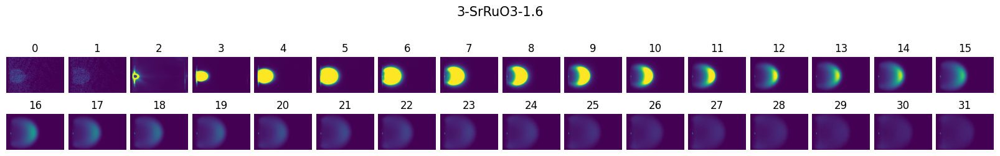

100%|██████████| 6/6 [00:00<00:00,  8.85it/s]


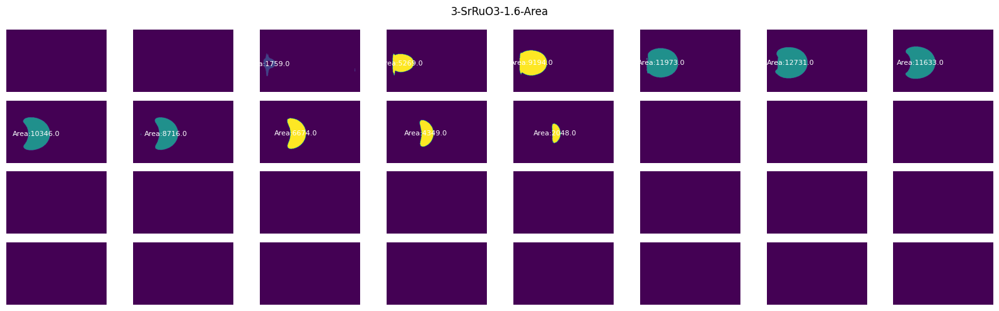

100%|██████████| 6/6 [00:00<00:00,  7.79it/s]


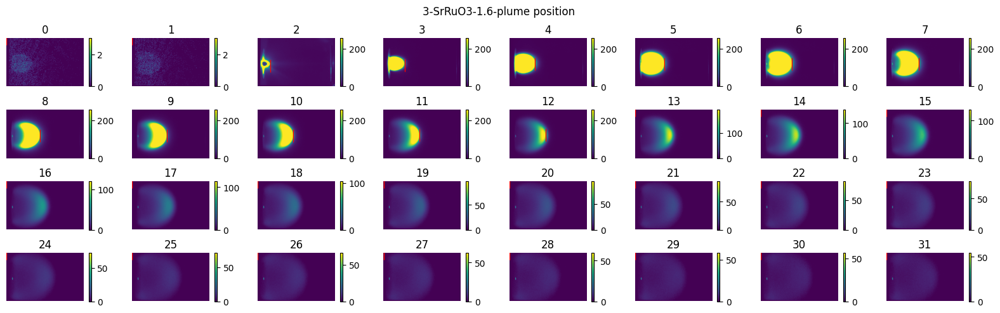

D:/pld_plumes/SRO_STO_Drexel/SRO_Mapping\SRO_Plume_Mapping_100mTorr_YichenGuo_08042024.h5 100 1.2


100%|██████████| 6/6 [00:02<00:00,  2.43it/s]


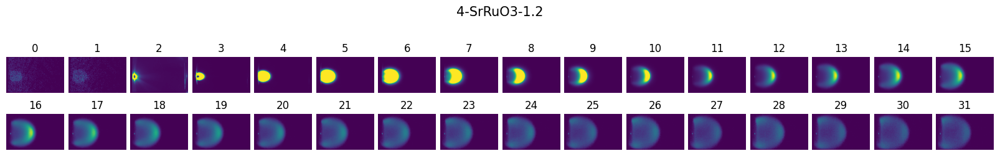

100%|██████████| 6/6 [00:00<00:00,  8.89it/s]


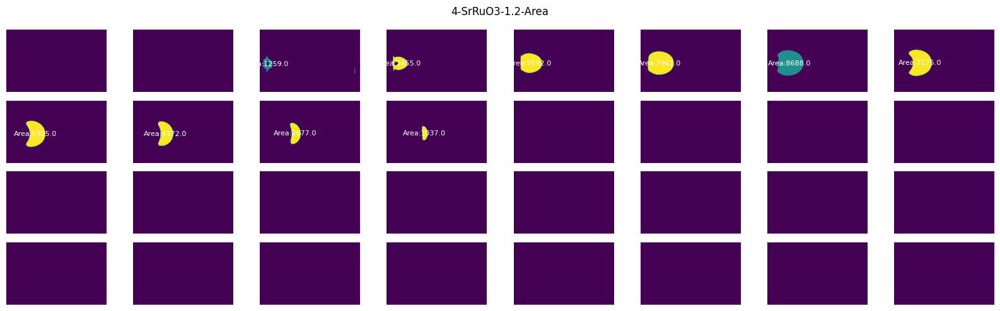

100%|██████████| 6/6 [00:00<00:00,  7.70it/s]


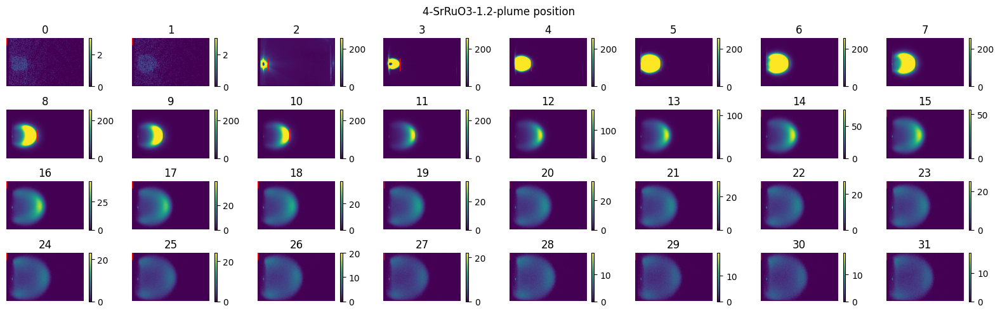

D:/pld_plumes/SRO_STO_Drexel/SRO_Mapping\SRO_Plume_Mapping_100mTorr_YichenGuo_08042024.h5 100 0.8


100%|██████████| 6/6 [00:01<00:00,  4.14it/s]


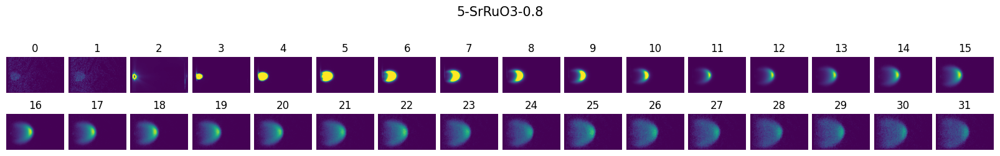

100%|██████████| 6/6 [00:00<00:00,  9.05it/s]


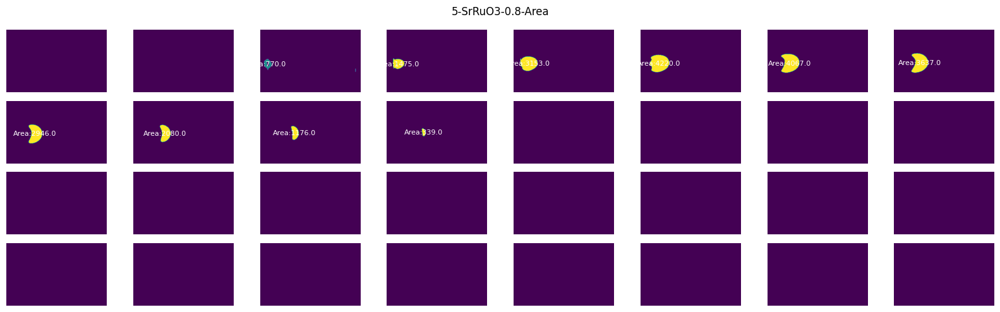

100%|██████████| 6/6 [00:00<00:00,  7.94it/s]


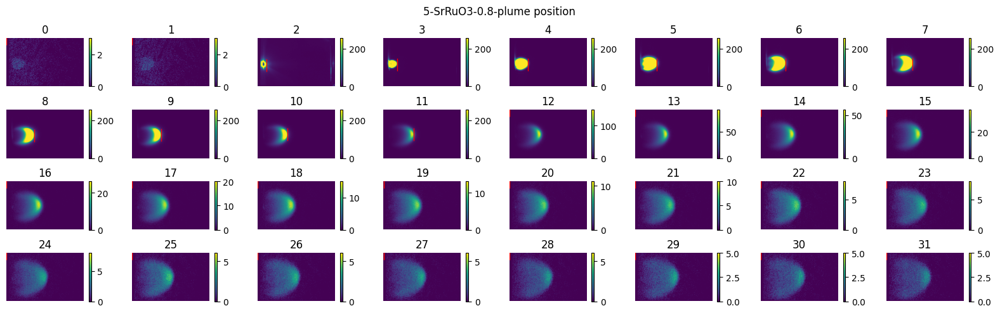

D:/pld_plumes/SRO_STO_Drexel/SRO_Mapping\SRO_Plume_Mapping_125mTorr_YichenGuo_08042024.h5 125 2.2


100%|██████████| 6/6 [00:02<00:00,  2.18it/s]


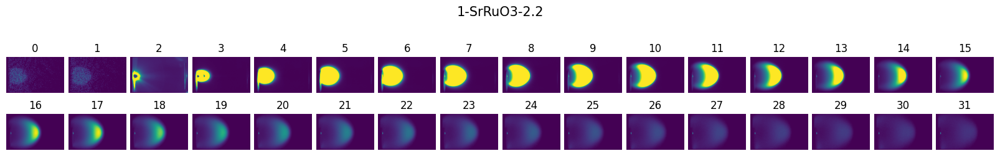

100%|██████████| 6/6 [00:00<00:00,  7.36it/s]


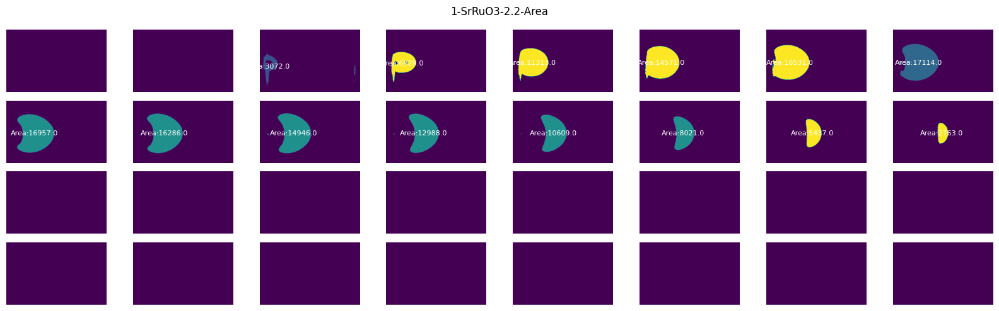

100%|██████████| 6/6 [00:00<00:00,  7.67it/s]


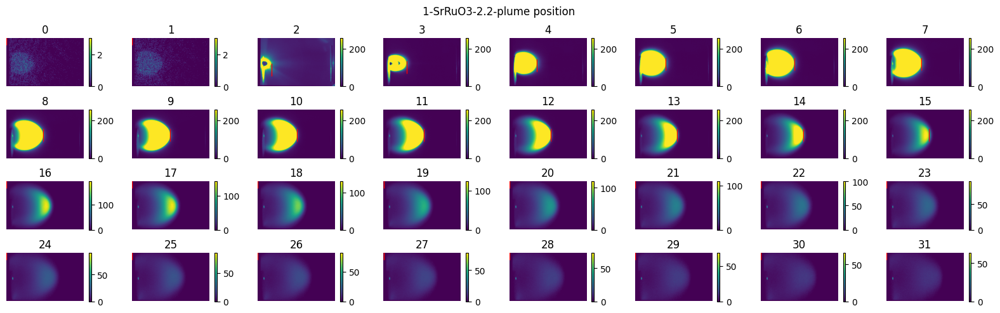

D:/pld_plumes/SRO_STO_Drexel/SRO_Mapping\SRO_Plume_Mapping_125mTorr_YichenGuo_08042024.h5 125 2


100%|██████████| 6/6 [00:02<00:00,  2.41it/s]


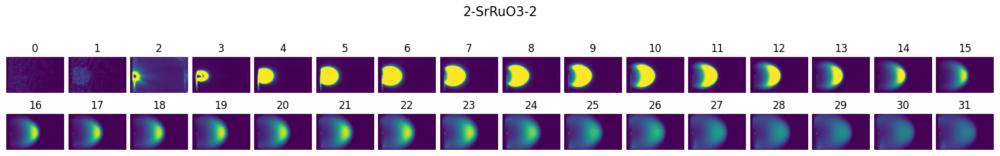

100%|██████████| 6/6 [00:00<00:00,  8.61it/s]


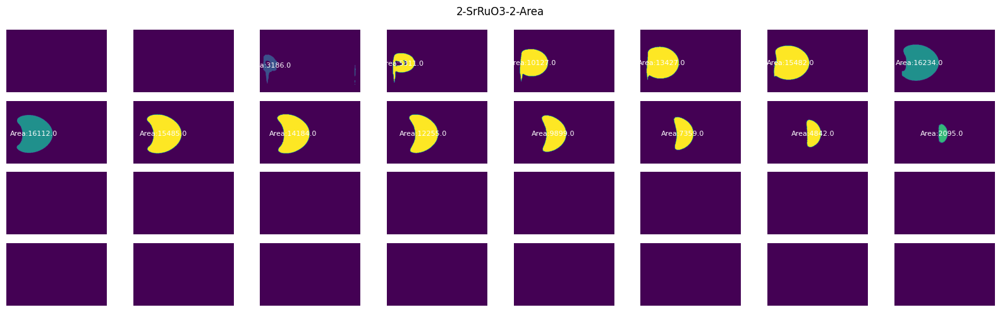

100%|██████████| 6/6 [00:00<00:00,  7.52it/s]


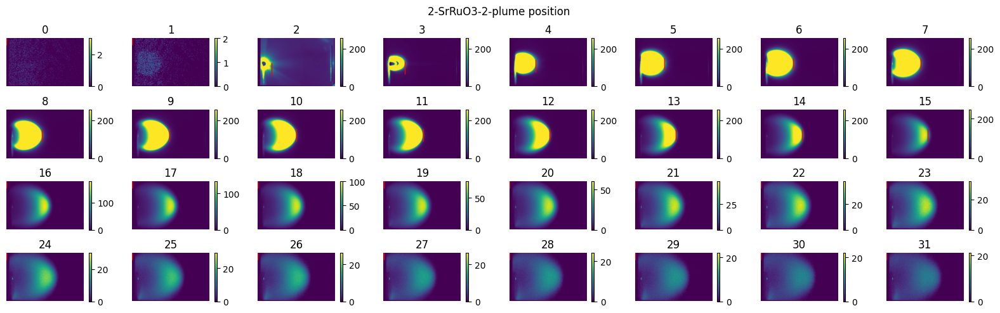

D:/pld_plumes/SRO_STO_Drexel/SRO_Mapping\SRO_Plume_Mapping_125mTorr_YichenGuo_08042024.h5 125 1.6


100%|██████████| 6/6 [00:02<00:00,  2.50it/s]


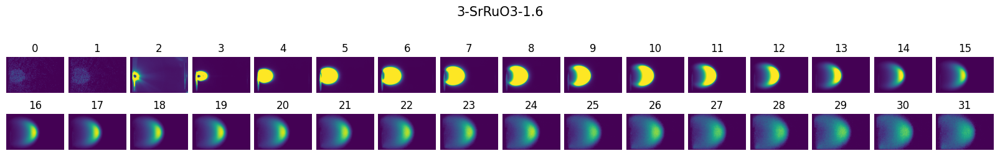

100%|██████████| 6/6 [00:00<00:00,  8.93it/s]


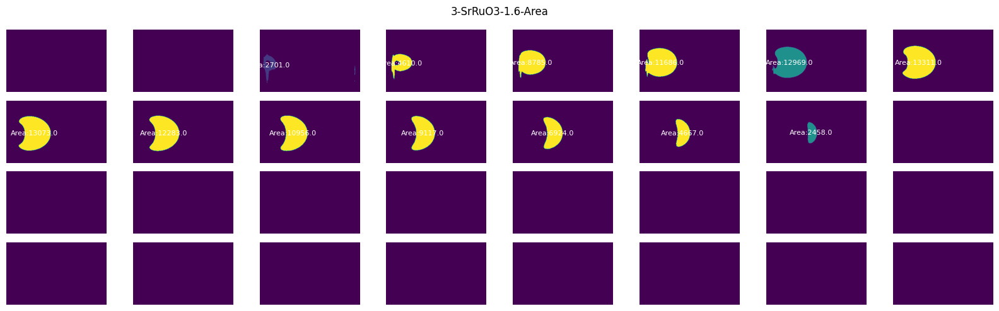

100%|██████████| 6/6 [00:00<00:00,  7.72it/s]


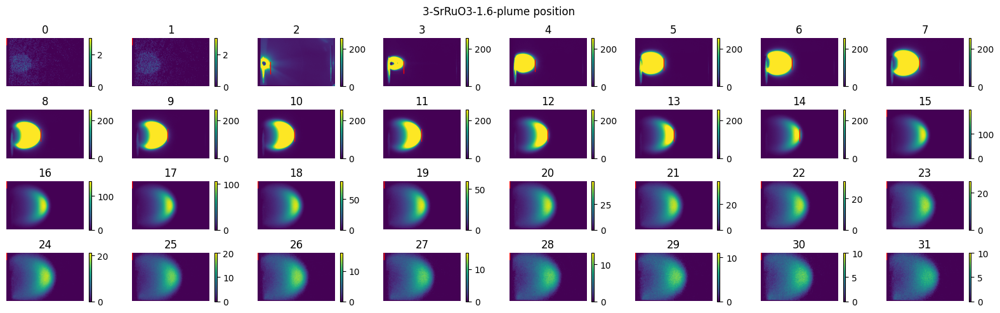

D:/pld_plumes/SRO_STO_Drexel/SRO_Mapping\SRO_Plume_Mapping_125mTorr_YichenGuo_08042024.h5 125 1.2


100%|██████████| 6/6 [00:02<00:00,  2.64it/s]


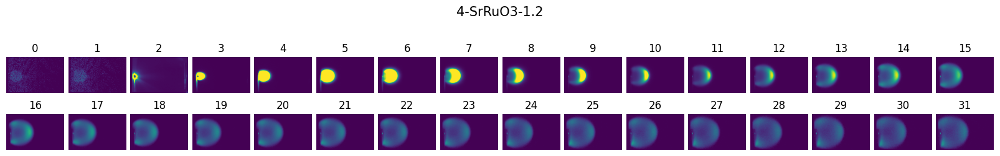

100%|██████████| 6/6 [00:00<00:00,  8.76it/s]


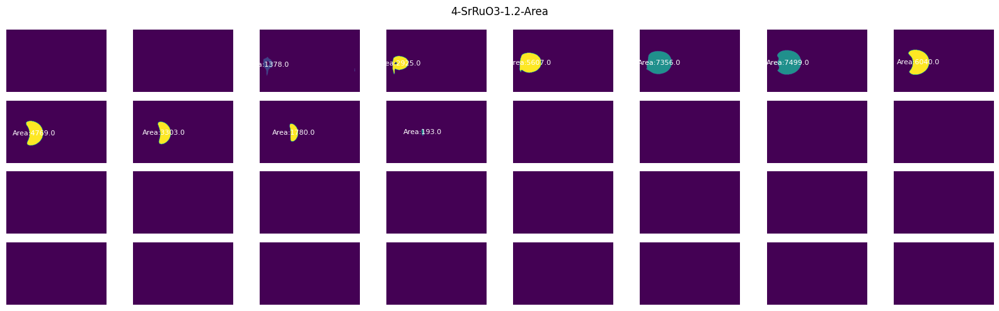

100%|██████████| 6/6 [00:00<00:00,  7.74it/s]


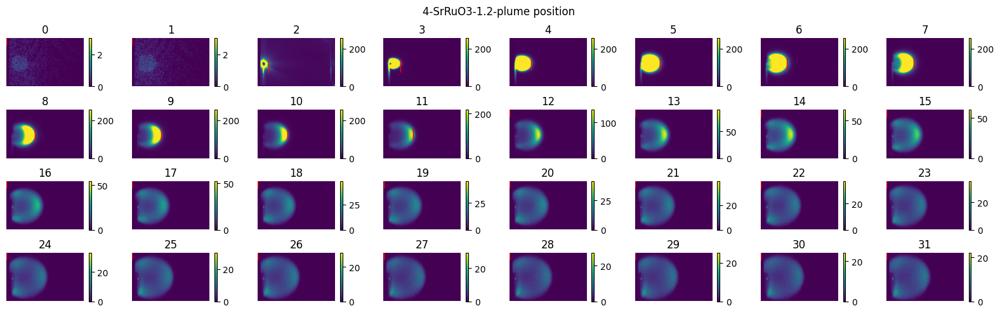

D:/pld_plumes/SRO_STO_Drexel/SRO_Mapping\SRO_Plume_Mapping_125mTorr_YichenGuo_08042024.h5 125 0.8


100%|██████████| 6/6 [00:01<00:00,  4.27it/s]


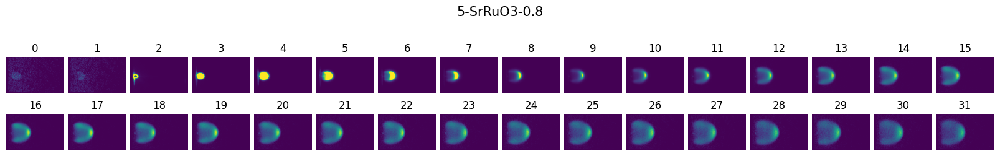

100%|██████████| 6/6 [00:00<00:00,  7.52it/s]


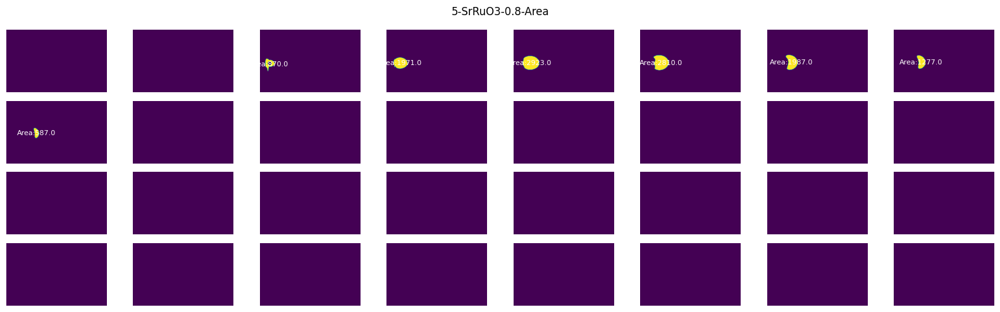

100%|██████████| 6/6 [00:00<00:00,  7.69it/s]


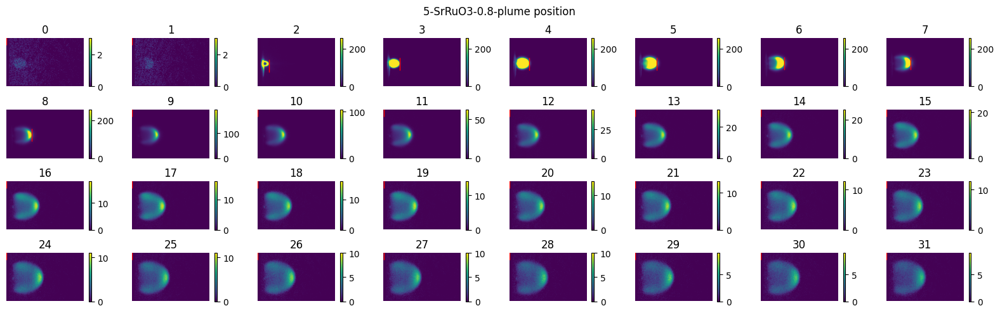

D:/pld_plumes/SRO_STO_Drexel/SRO_Mapping\SRO_Plume_Mapping_150mTorr_YichenGuo_08042024.h5 150 2.2


100%|██████████| 6/6 [00:02<00:00,  2.13it/s]


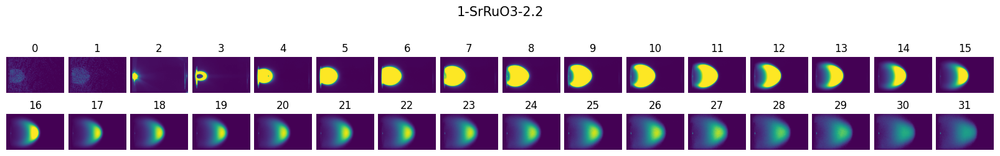

100%|██████████| 6/6 [00:00<00:00,  7.09it/s]


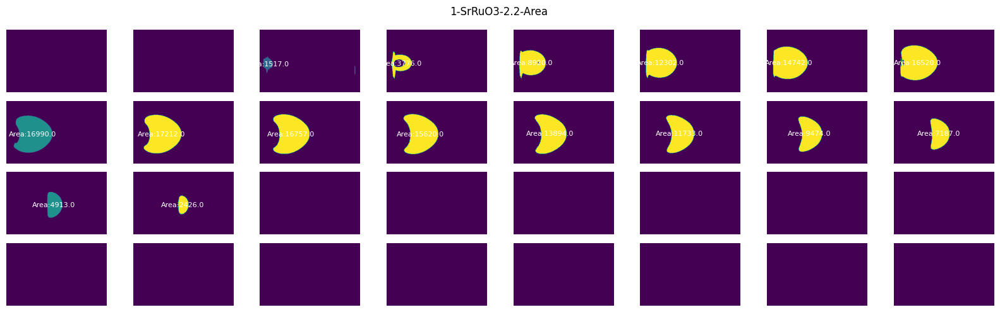

100%|██████████| 6/6 [00:00<00:00,  7.77it/s]


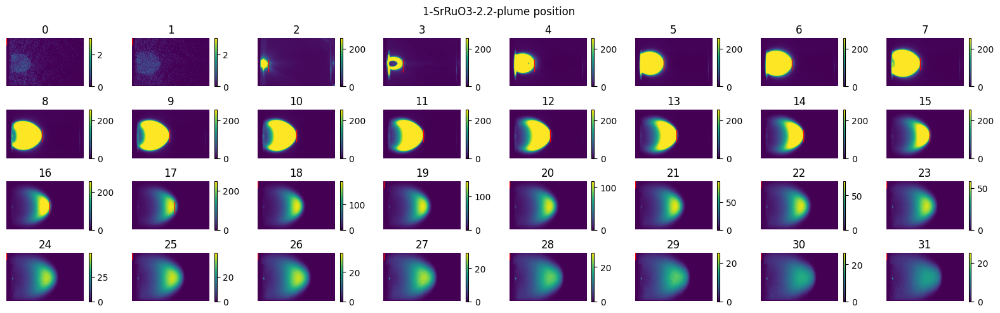

D:/pld_plumes/SRO_STO_Drexel/SRO_Mapping\SRO_Plume_Mapping_150mTorr_YichenGuo_08042024.h5 150 2


100%|██████████| 6/6 [00:02<00:00,  2.25it/s]


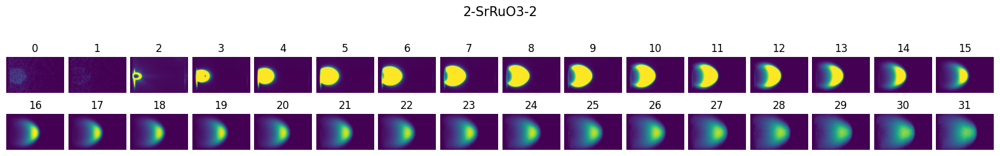

100%|██████████| 6/6 [00:00<00:00,  7.21it/s]


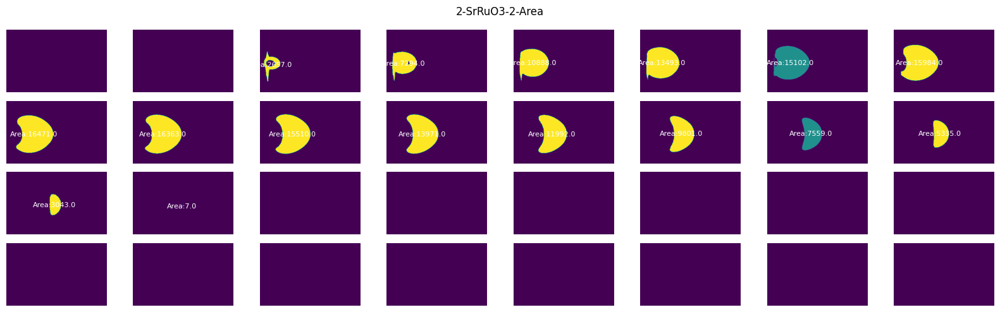

100%|██████████| 6/6 [00:00<00:00,  7.68it/s]


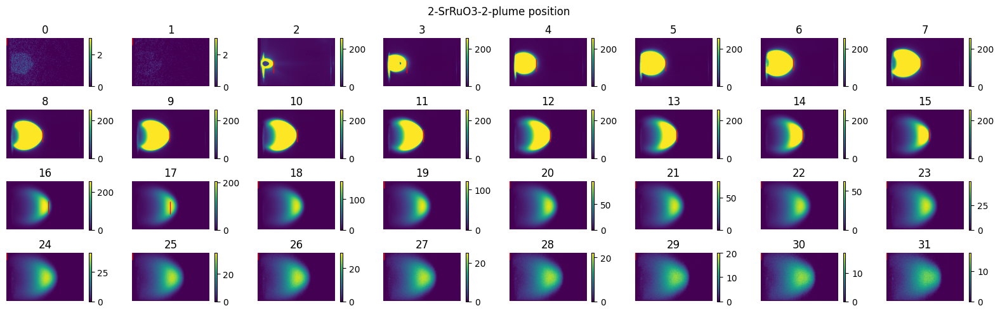

D:/pld_plumes/SRO_STO_Drexel/SRO_Mapping\SRO_Plume_Mapping_150mTorr_YichenGuo_08042024.h5 150 1.6


100%|██████████| 6/6 [00:02<00:00,  2.53it/s]


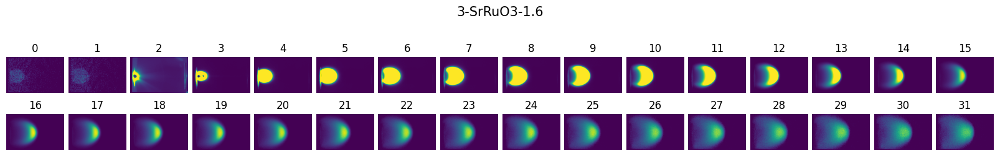

100%|██████████| 6/6 [00:00<00:00,  7.41it/s]


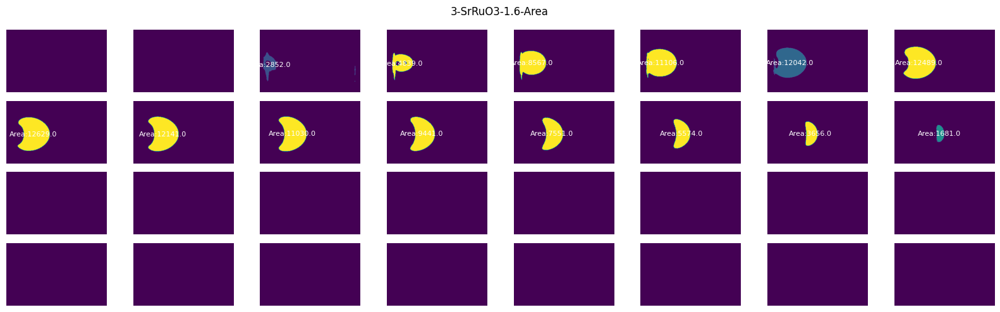

100%|██████████| 6/6 [00:00<00:00,  7.87it/s]


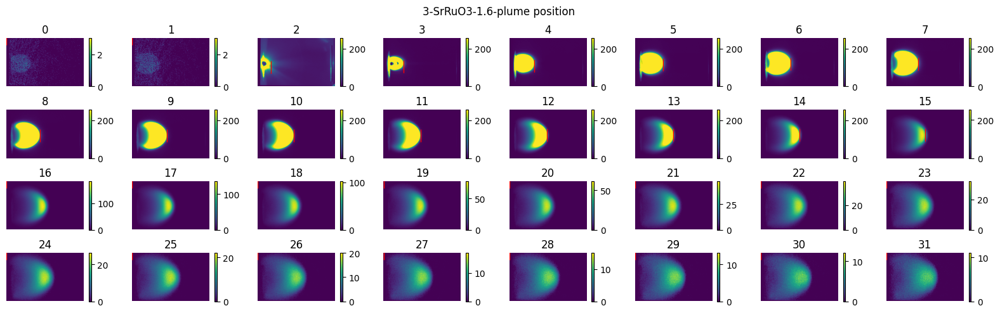

D:/pld_plumes/SRO_STO_Drexel/SRO_Mapping\SRO_Plume_Mapping_150mTorr_YichenGuo_08042024.h5 150 1.2


100%|██████████| 6/6 [00:02<00:00,  2.25it/s]


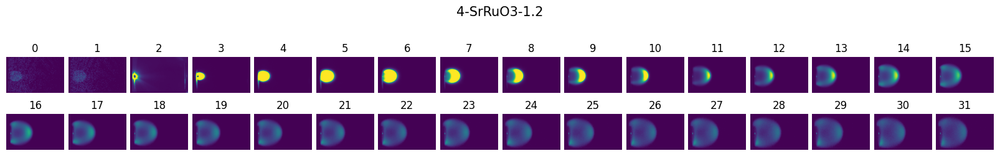

100%|██████████| 6/6 [00:00<00:00,  7.38it/s]


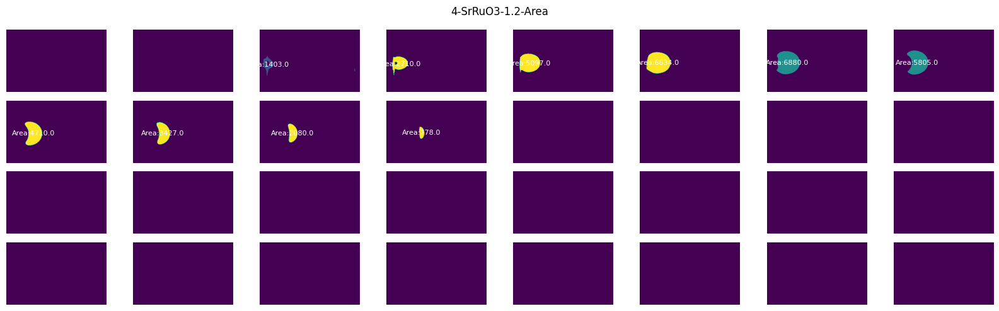

100%|██████████| 6/6 [00:00<00:00,  7.94it/s]


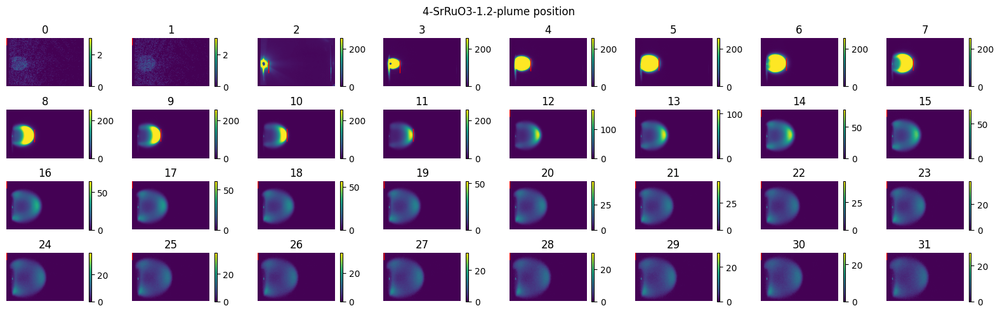

D:/pld_plumes/SRO_STO_Drexel/SRO_Mapping\SRO_Plume_Mapping_150mTorr_YichenGuo_08042024.h5 150 0.8


100%|██████████| 6/6 [00:01<00:00,  4.43it/s]


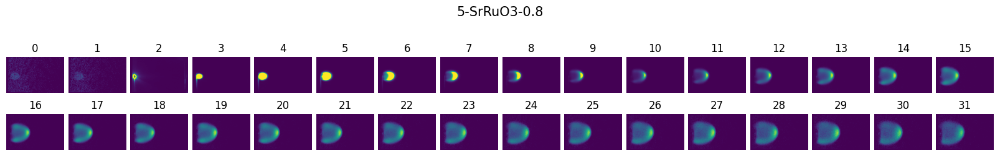

100%|██████████| 6/6 [00:00<00:00,  7.46it/s]


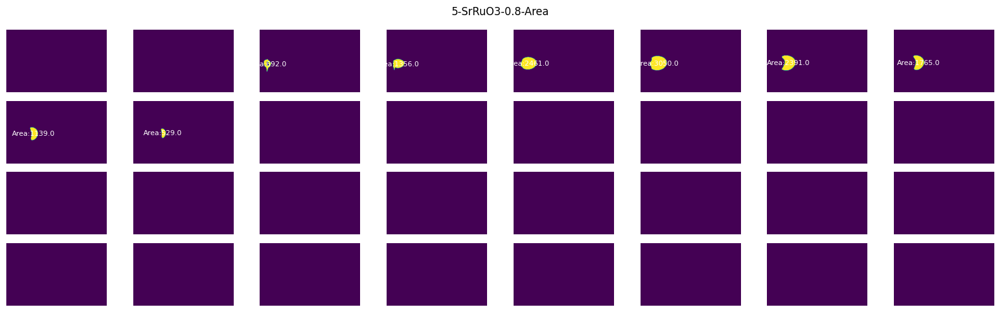

100%|██████████| 6/6 [00:00<00:00,  8.02it/s]


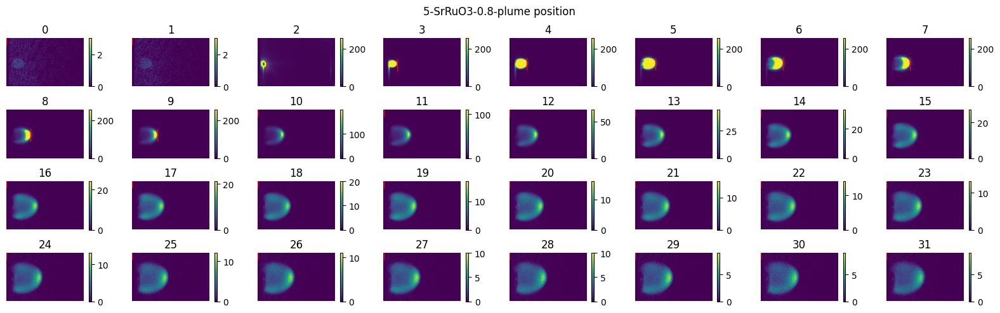

D:/pld_plumes/SRO_STO_Drexel/SRO_Mapping\SRO_Plume_Mapping_175mTorr_YichenGuo_08042024.h5 175 2.2


100%|██████████| 6/6 [00:03<00:00,  1.98it/s]


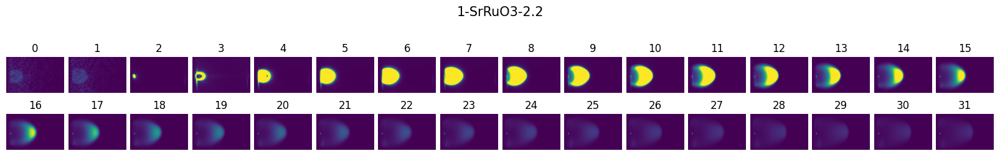

100%|██████████| 6/6 [00:00<00:00,  8.30it/s]


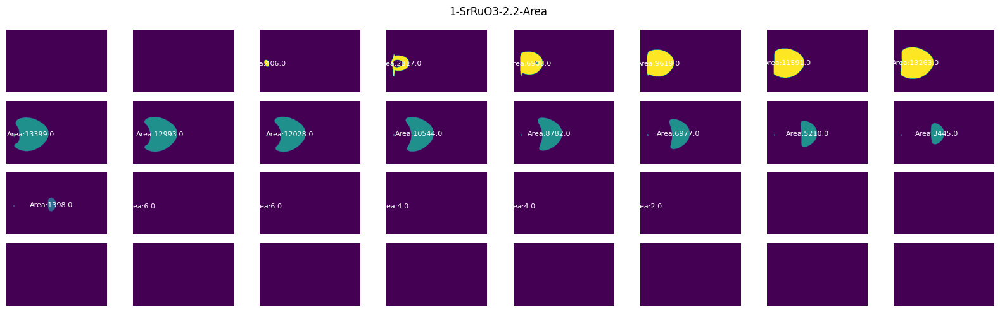

100%|██████████| 6/6 [00:00<00:00,  7.68it/s]


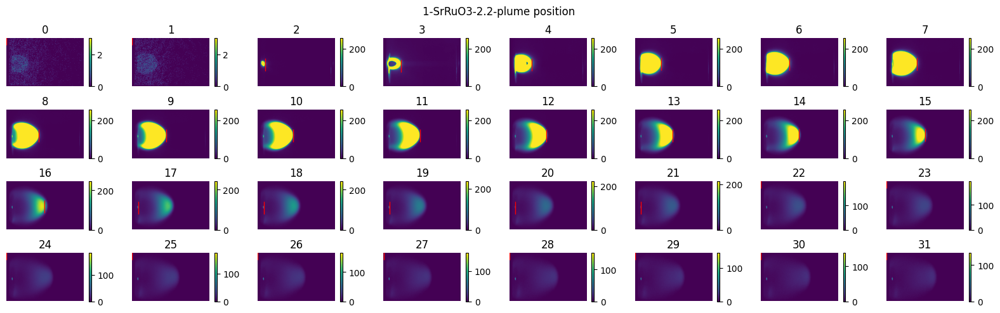

D:/pld_plumes/SRO_STO_Drexel/SRO_Mapping\SRO_Plume_Mapping_175mTorr_YichenGuo_08042024.h5 175 2


100%|██████████| 6/6 [00:02<00:00,  2.05it/s]


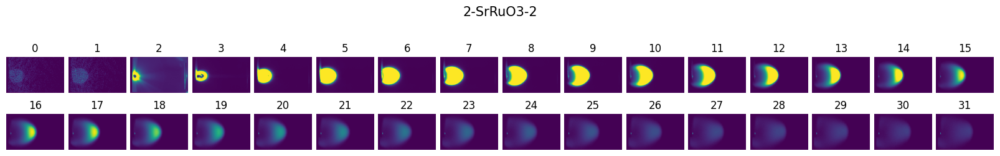

100%|██████████| 6/6 [00:00<00:00,  8.64it/s]


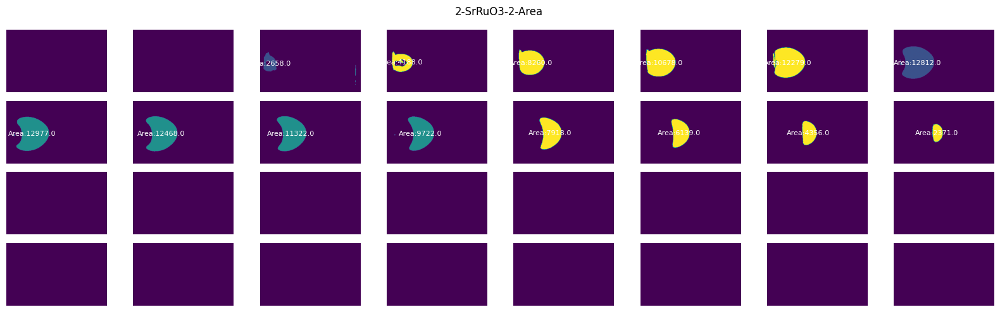

100%|██████████| 6/6 [00:00<00:00,  7.53it/s]


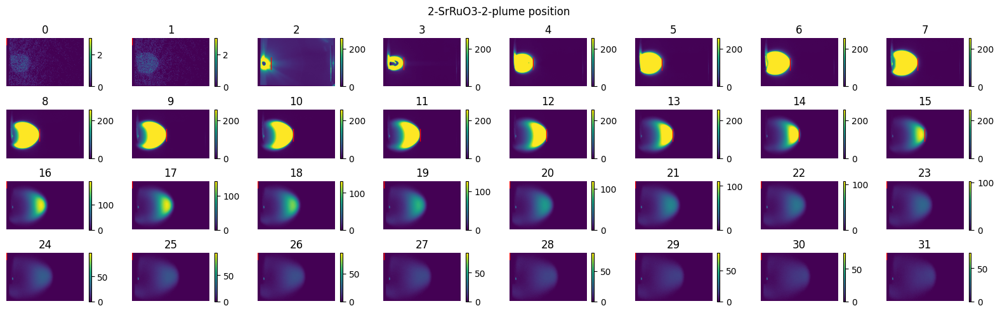

D:/pld_plumes/SRO_STO_Drexel/SRO_Mapping\SRO_Plume_Mapping_175mTorr_YichenGuo_08042024.h5 175 1.6


100%|██████████| 6/6 [00:02<00:00,  2.26it/s]


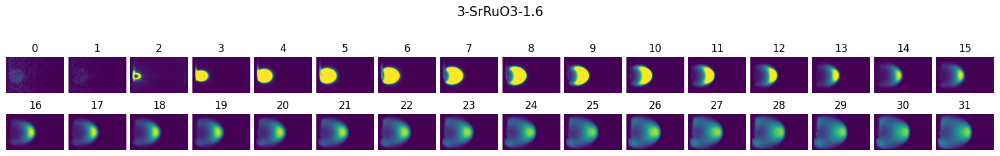

100%|██████████| 6/6 [00:00<00:00,  7.40it/s]


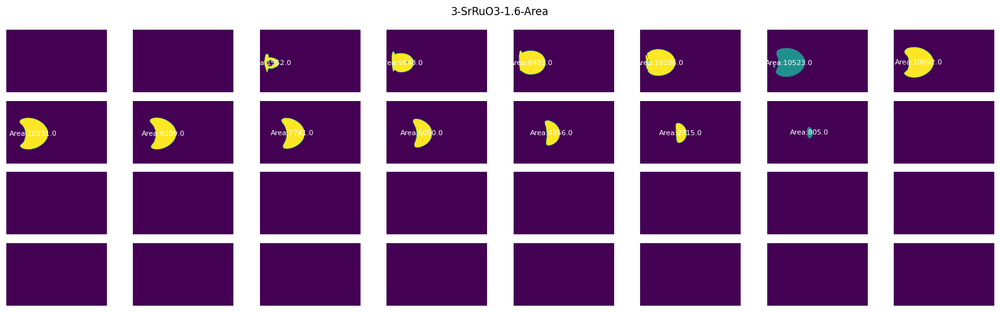

100%|██████████| 6/6 [00:00<00:00,  7.84it/s]


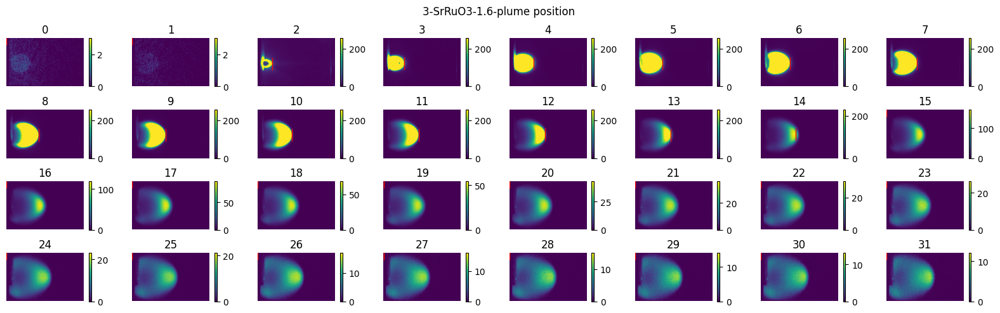

D:/pld_plumes/SRO_STO_Drexel/SRO_Mapping\SRO_Plume_Mapping_175mTorr_YichenGuo_08042024.h5 175 1.2


100%|██████████| 6/6 [00:03<00:00,  1.78it/s]


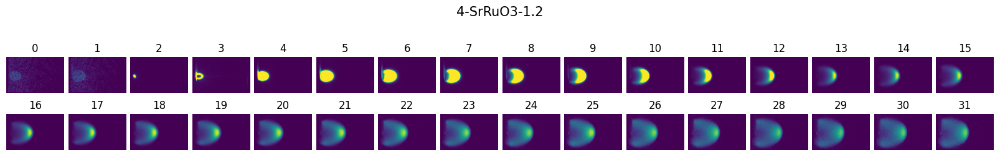

100%|██████████| 6/6 [00:00<00:00,  7.36it/s]


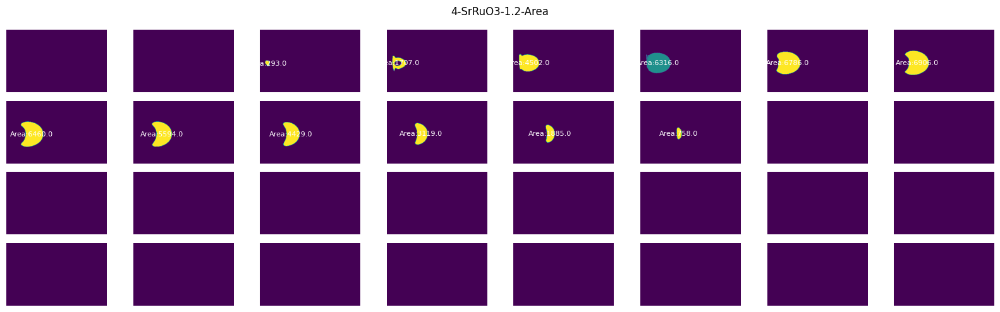

100%|██████████| 6/6 [00:00<00:00, 15.42it/s]


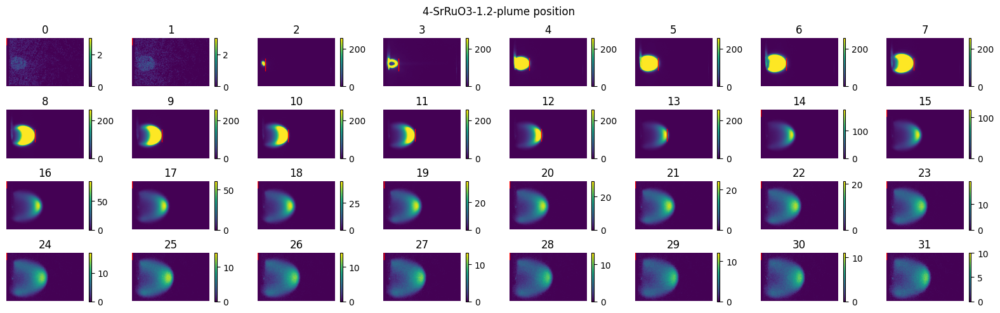

D:/pld_plumes/SRO_STO_Drexel/SRO_Mapping\SRO_Plume_Mapping_175mTorr_YichenGuo_08042024.h5 175 0.8


100%|██████████| 6/6 [00:01<00:00,  3.69it/s]


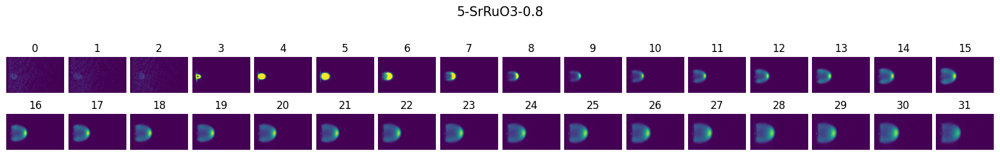

100%|██████████| 6/6 [00:00<00:00,  8.88it/s]


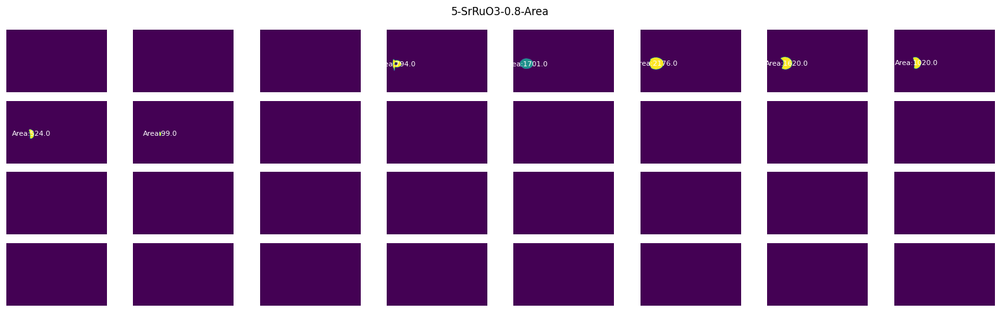

100%|██████████| 6/6 [00:00<00:00, 15.42it/s]


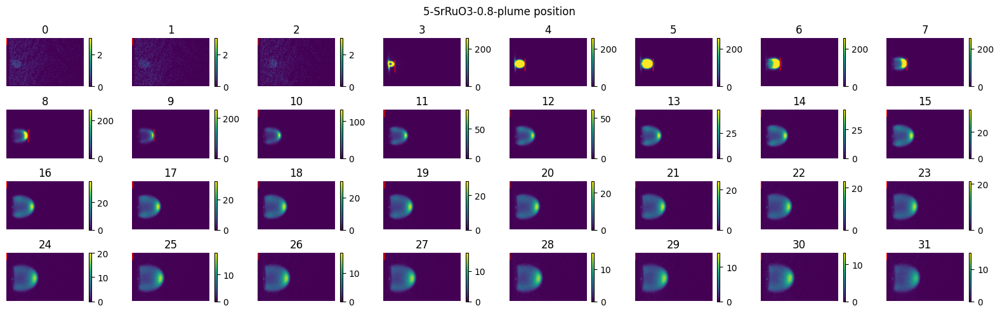

D:/pld_plumes/SRO_STO_Drexel/SRO_Mapping\SRO_Plume_Mapping_200mTorr_YichenGuo_08042024.h5 200 2.2


100%|██████████| 6/6 [00:03<00:00,  1.88it/s]


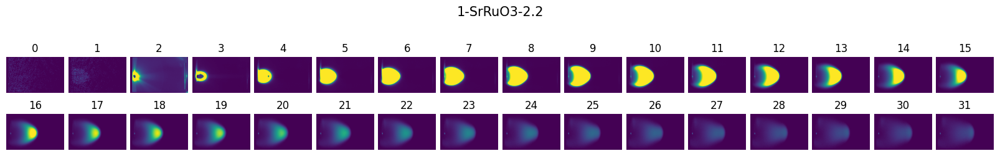

100%|██████████| 6/6 [00:00<00:00,  8.41it/s]


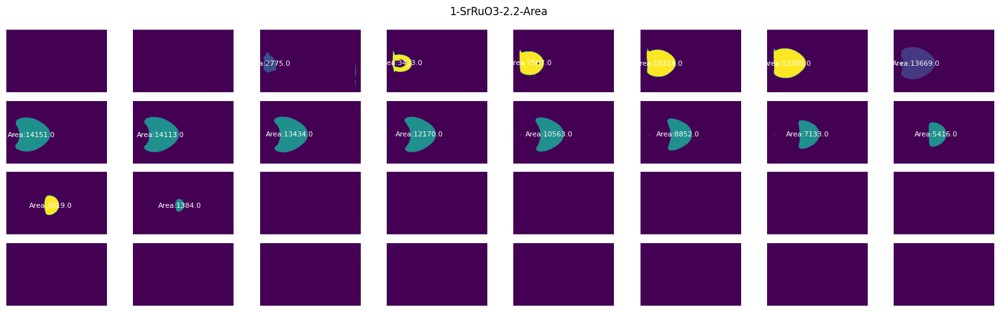

100%|██████████| 6/6 [00:00<00:00, 14.92it/s]


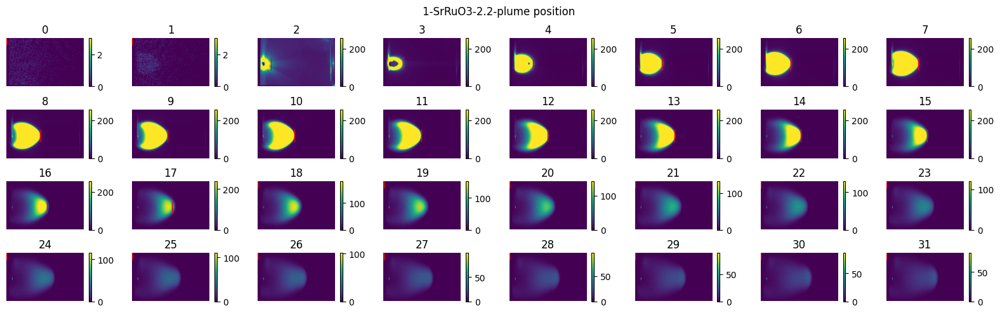

D:/pld_plumes/SRO_STO_Drexel/SRO_Mapping\SRO_Plume_Mapping_200mTorr_YichenGuo_08042024.h5 200 2


100%|██████████| 6/6 [00:03<00:00,  1.85it/s]


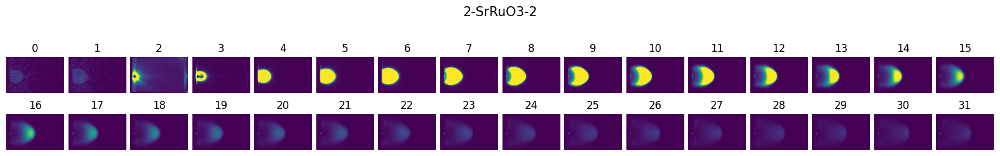

100%|██████████| 6/6 [00:00<00:00,  8.72it/s]


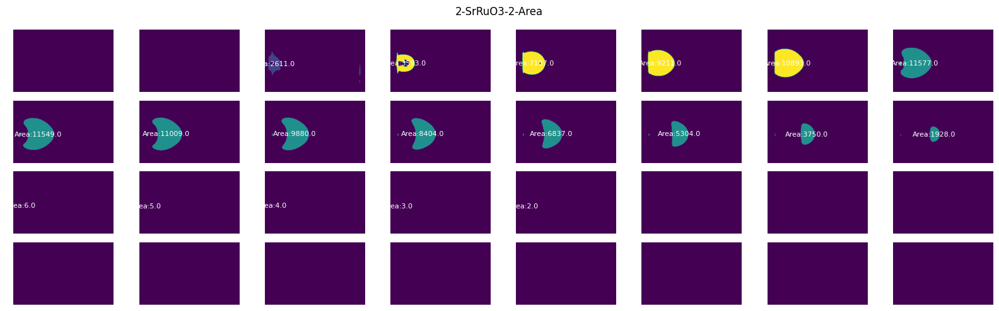

100%|██████████| 6/6 [00:00<00:00,  7.77it/s]


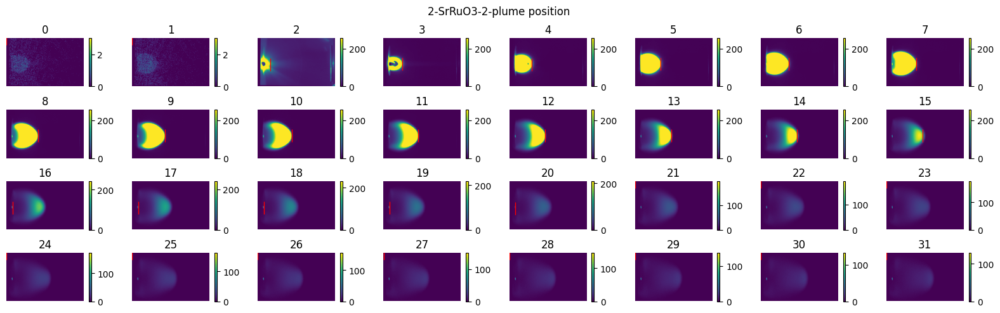

D:/pld_plumes/SRO_STO_Drexel/SRO_Mapping\SRO_Plume_Mapping_200mTorr_YichenGuo_08042024.h5 200 1.6


100%|██████████| 6/6 [00:04<00:00,  1.38it/s]


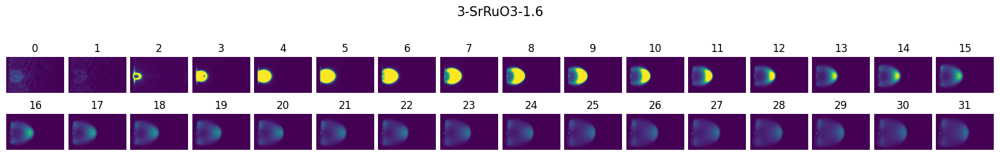

100%|██████████| 6/6 [00:00<00:00,  8.95it/s]


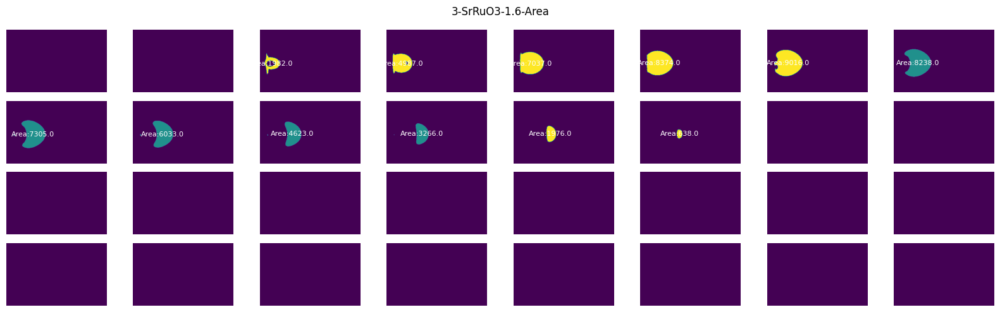

100%|██████████| 6/6 [00:00<00:00,  8.03it/s]


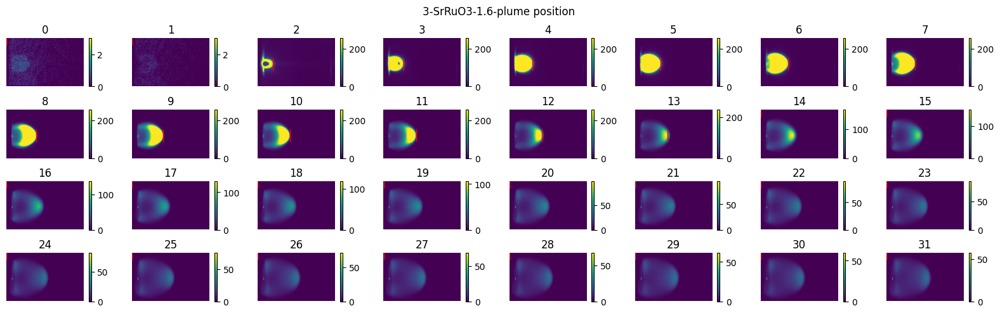

D:/pld_plumes/SRO_STO_Drexel/SRO_Mapping\SRO_Plume_Mapping_200mTorr_YichenGuo_08042024.h5 200 1.2


100%|██████████| 6/6 [00:04<00:00,  1.38it/s]


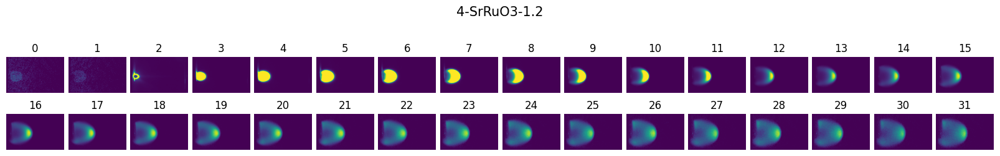

100%|██████████| 6/6 [00:00<00:00,  7.42it/s]


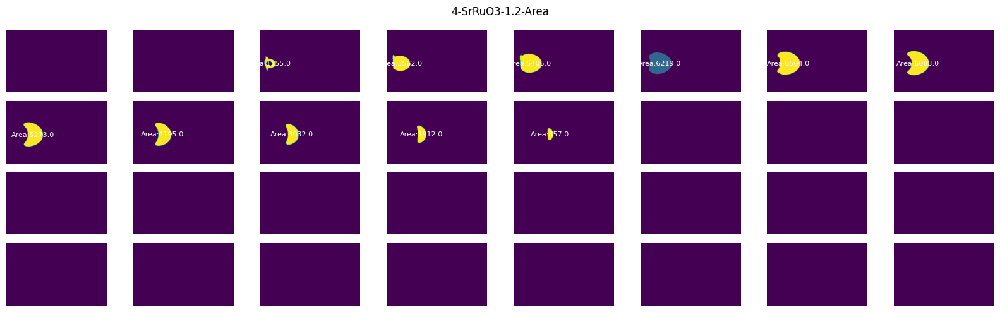

100%|██████████| 6/6 [00:00<00:00,  7.86it/s]


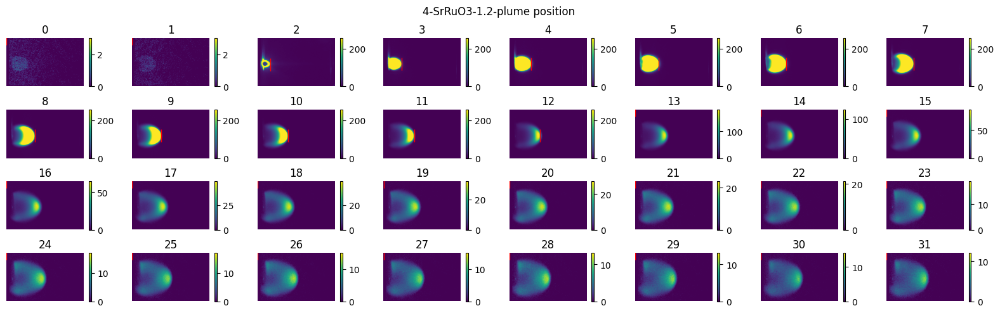

D:/pld_plumes/SRO_STO_Drexel/SRO_Mapping\SRO_Plume_Mapping_200mTorr_YichenGuo_08042024.h5 200 0.8


100%|██████████| 6/6 [00:02<00:00,  2.73it/s]


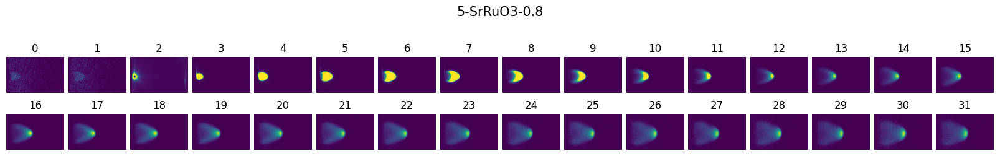

100%|██████████| 6/6 [00:00<00:00,  8.73it/s]


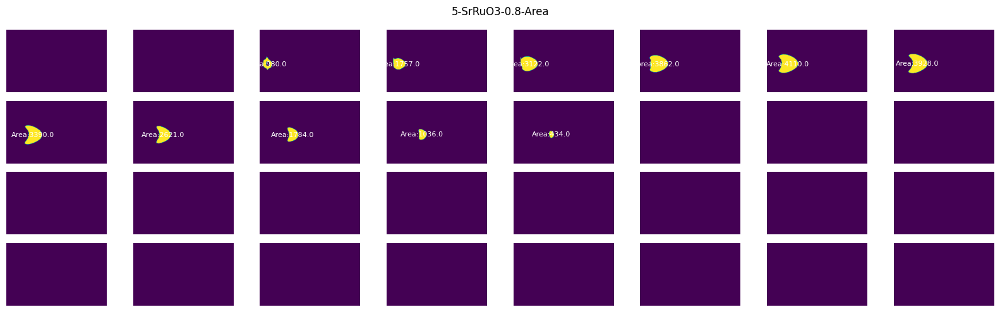

100%|██████████| 6/6 [00:00<00:00,  8.06it/s]


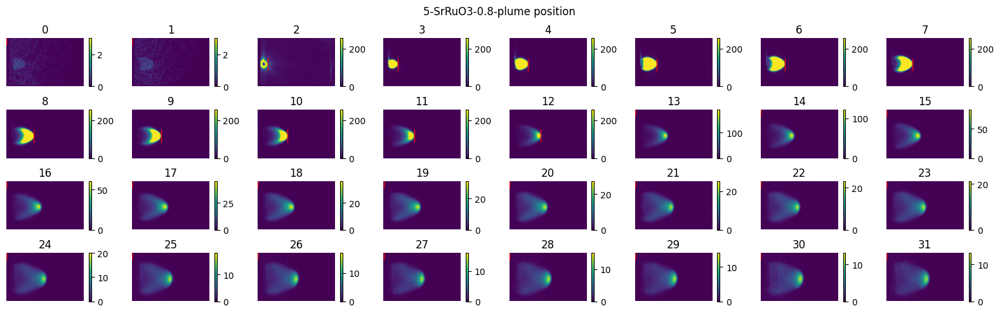

D:/pld_plumes/SRO_STO_Drexel/SRO_Mapping\SRO_Plume_Mapping_50mTorr_YichenGuo_08042024.h5 50 2.2


100%|██████████| 36/36 [00:19<00:00,  1.81it/s]


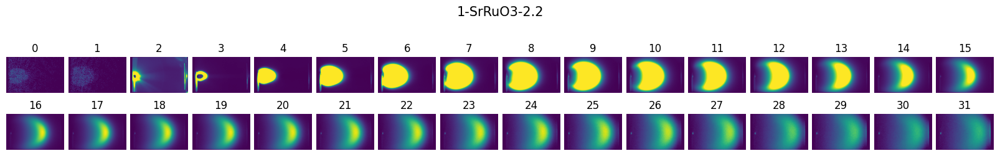

100%|██████████| 36/36 [00:05<00:00,  7.05it/s]


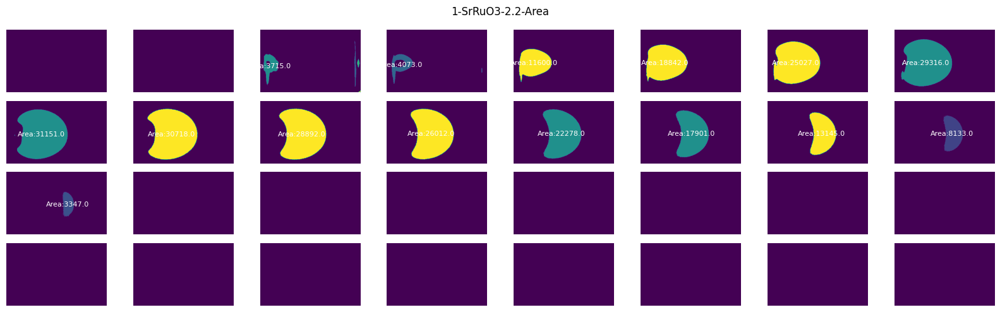

100%|██████████| 36/36 [00:04<00:00,  7.59it/s]


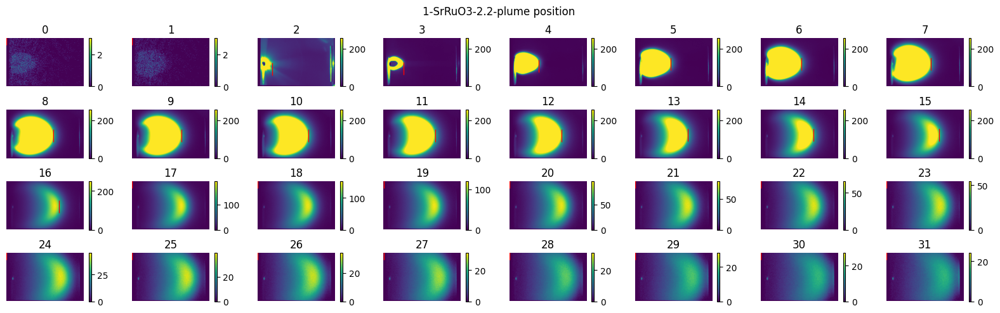

D:/pld_plumes/SRO_STO_Drexel/SRO_Mapping\SRO_Plume_Mapping_50mTorr_YichenGuo_08042024.h5 50 2


100%|██████████| 54/54 [00:29<00:00,  1.82it/s]


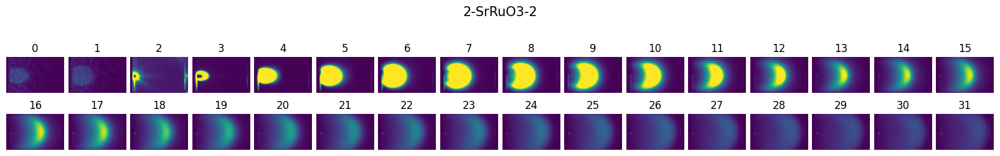

100%|██████████| 54/54 [00:07<00:00,  7.06it/s]


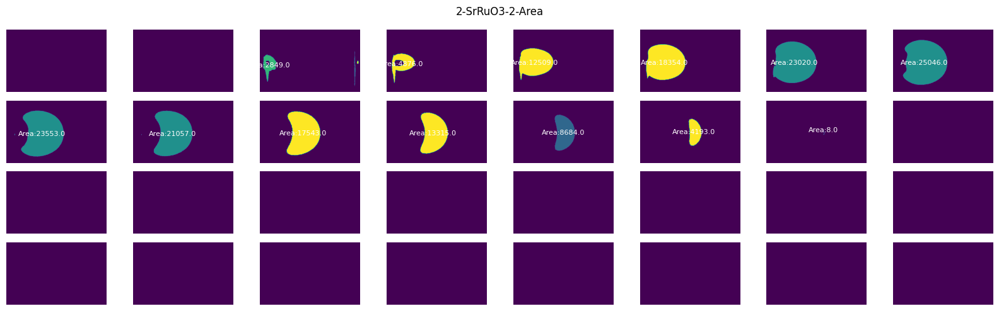

100%|██████████| 54/54 [00:03<00:00, 14.25it/s]


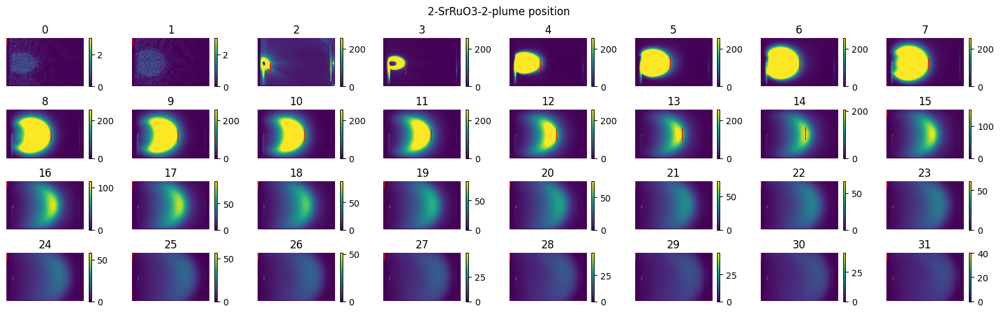

D:/pld_plumes/SRO_STO_Drexel/SRO_Mapping\SRO_Plume_Mapping_50mTorr_YichenGuo_08042024.h5 50 1.6


100%|██████████| 7/7 [00:03<00:00,  2.22it/s]


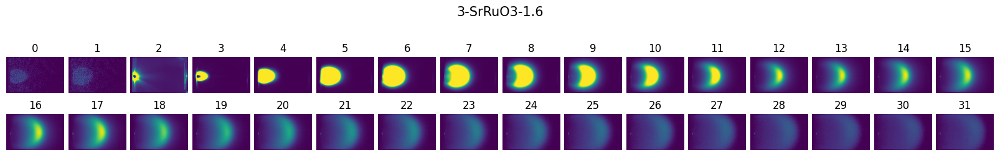

100%|██████████| 7/7 [00:00<00:00,  7.23it/s]


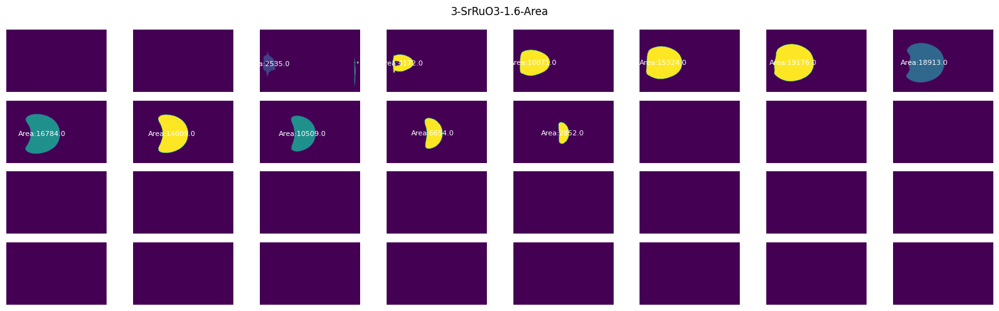

100%|██████████| 7/7 [00:00<00:00,  7.81it/s]


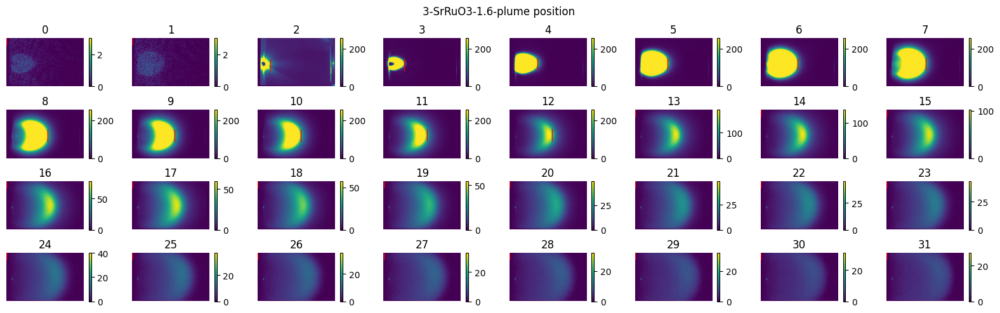

D:/pld_plumes/SRO_STO_Drexel/SRO_Mapping\SRO_Plume_Mapping_50mTorr_YichenGuo_08042024.h5 50 1.2


100%|██████████| 9/9 [00:03<00:00,  2.83it/s]


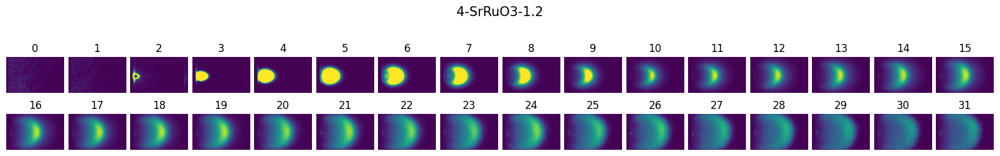

100%|██████████| 9/9 [00:01<00:00,  8.62it/s]


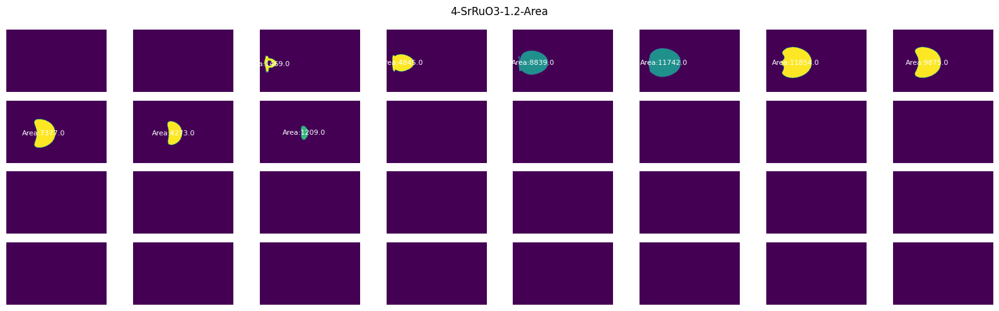

100%|██████████| 9/9 [00:01<00:00,  7.93it/s]


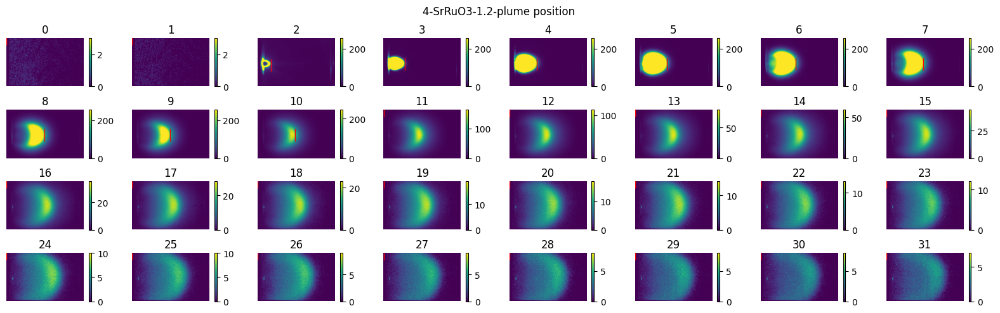

D:/pld_plumes/SRO_STO_Drexel/SRO_Mapping\SRO_Plume_Mapping_50mTorr_YichenGuo_08042024.h5 50 0.8


100%|██████████| 8/8 [00:01<00:00,  7.29it/s]


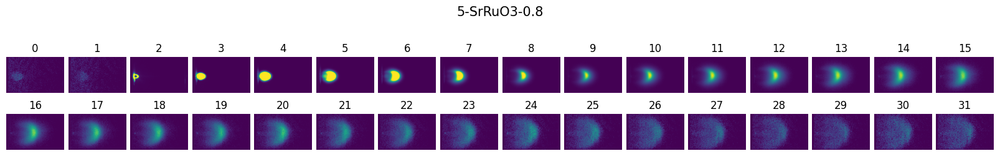

100%|██████████| 8/8 [00:00<00:00,  8.58it/s]


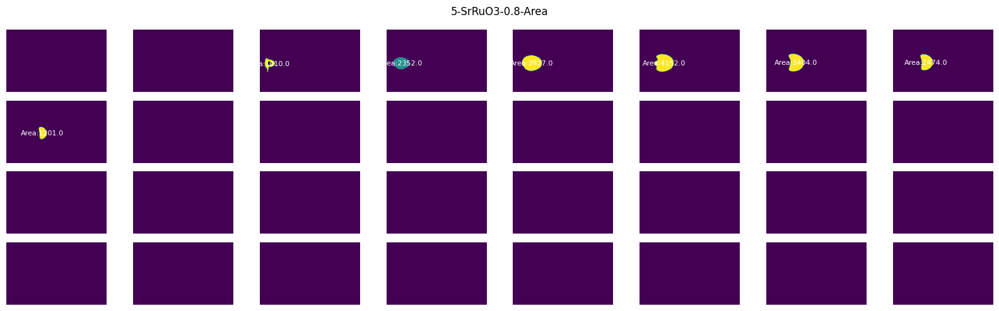

100%|██████████| 8/8 [00:00<00:00,  8.02it/s]


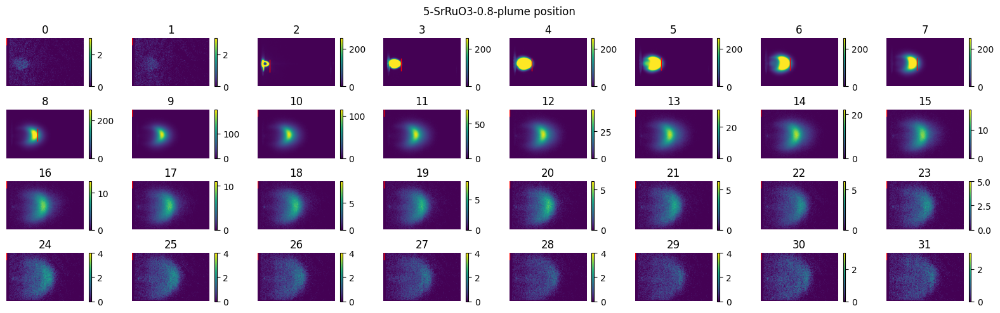

D:/pld_plumes/SRO_STO_Drexel/SRO_Mapping\SRO_Plume_Mapping_75mTorr_YichenGuo_08042024.h5 75 2.2


100%|██████████| 9/9 [00:04<00:00,  1.86it/s]


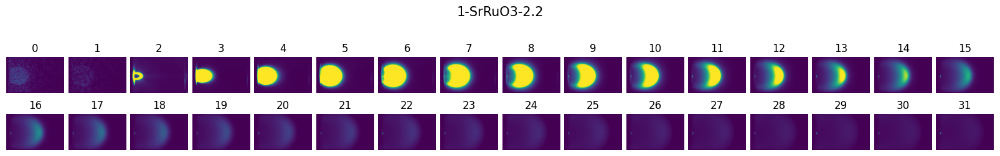

100%|██████████| 9/9 [00:01<00:00,  8.48it/s]


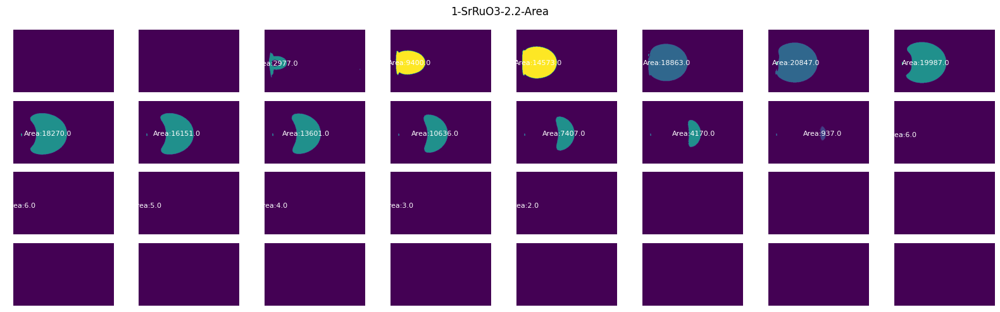

100%|██████████| 9/9 [00:01<00:00,  7.47it/s]


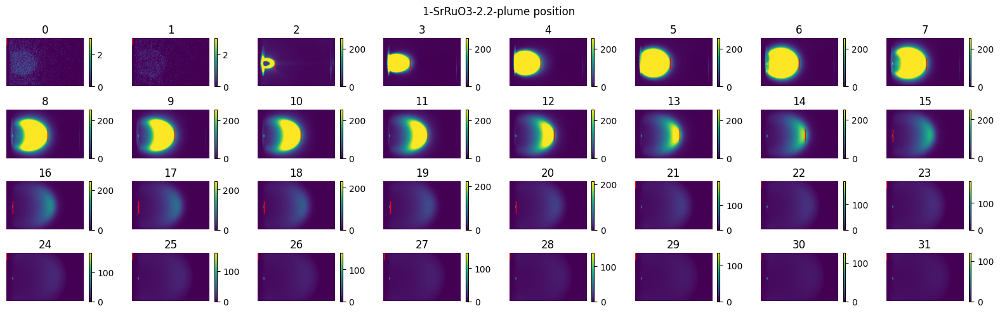

D:/pld_plumes/SRO_STO_Drexel/SRO_Mapping\SRO_Plume_Mapping_75mTorr_YichenGuo_08042024.h5 75 2


100%|██████████| 6/6 [00:02<00:00,  2.02it/s]


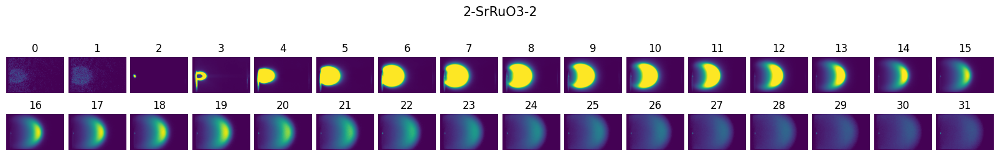

100%|██████████| 6/6 [00:00<00:00,  7.14it/s]


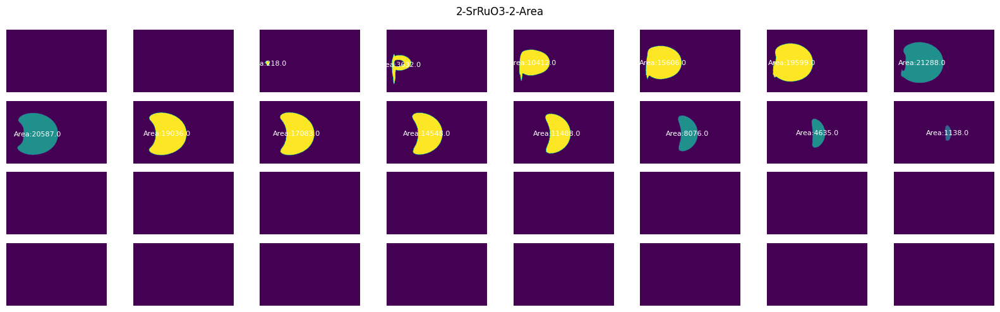

100%|██████████| 6/6 [00:00<00:00,  7.61it/s]


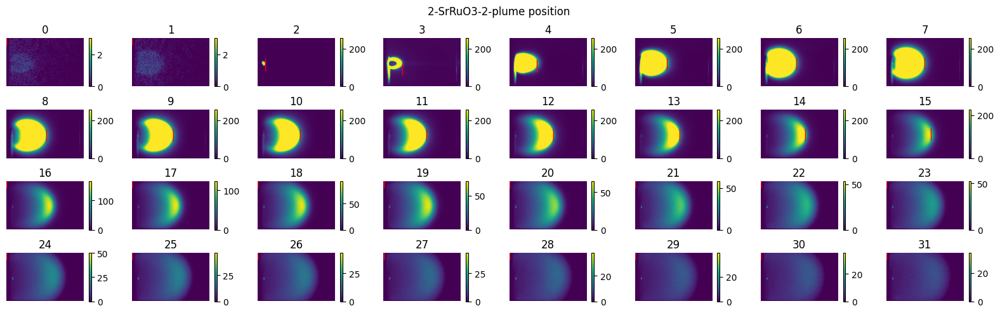

D:/pld_plumes/SRO_STO_Drexel/SRO_Mapping\SRO_Plume_Mapping_75mTorr_YichenGuo_08042024.h5 75 1.6


100%|██████████| 5/5 [00:02<00:00,  2.12it/s]


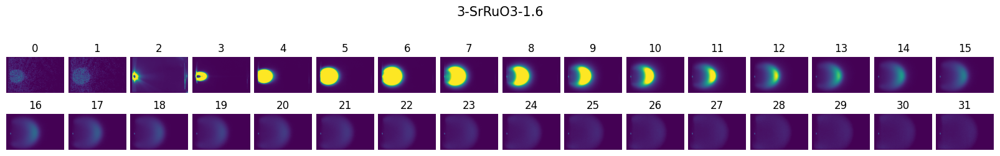

100%|██████████| 5/5 [00:00<00:00,  7.08it/s]


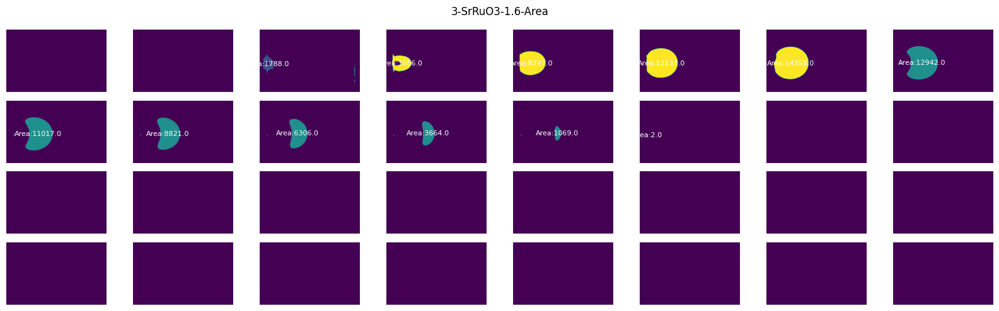

100%|██████████| 5/5 [00:00<00:00,  7.85it/s]


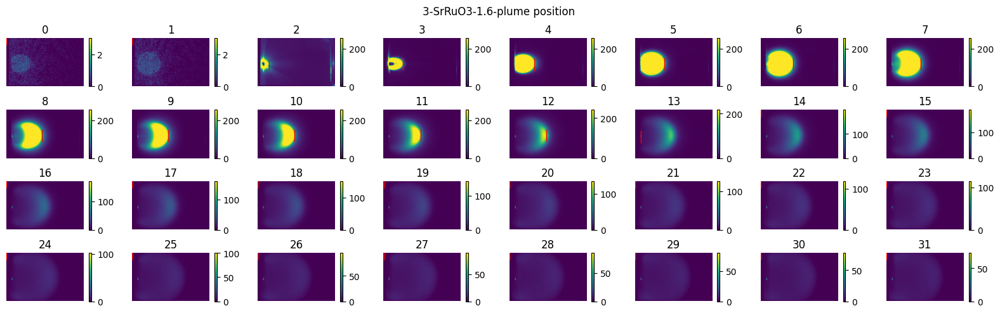

D:/pld_plumes/SRO_STO_Drexel/SRO_Mapping\SRO_Plume_Mapping_75mTorr_YichenGuo_08042024.h5 75 1.2


100%|██████████| 6/6 [00:02<00:00,  2.53it/s]


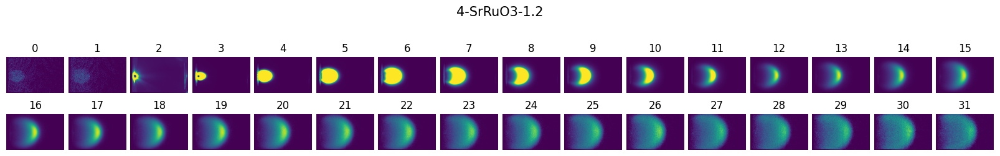

100%|██████████| 6/6 [00:00<00:00,  7.16it/s]


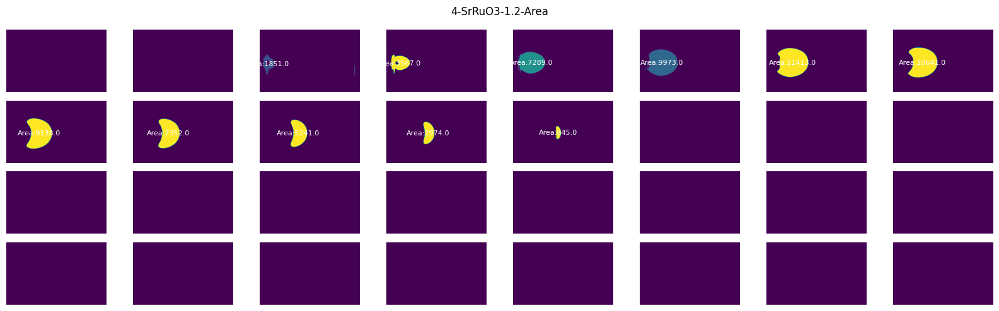

100%|██████████| 6/6 [00:00<00:00,  7.61it/s]


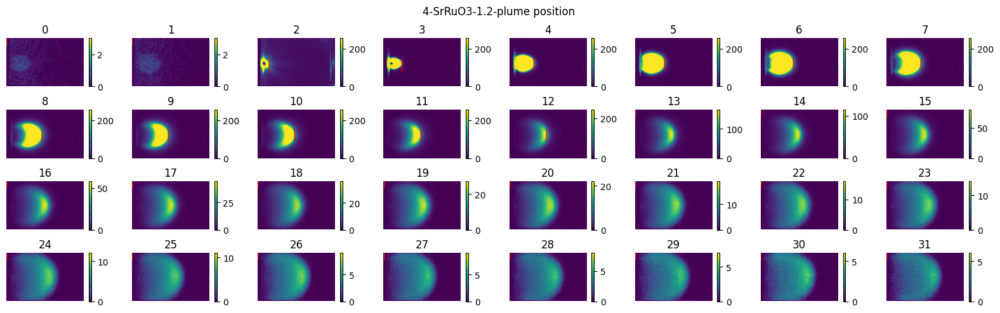

D:/pld_plumes/SRO_STO_Drexel/SRO_Mapping\SRO_Plume_Mapping_75mTorr_YichenGuo_08042024.h5 75 0.8


100%|██████████| 6/6 [00:01<00:00,  5.29it/s]


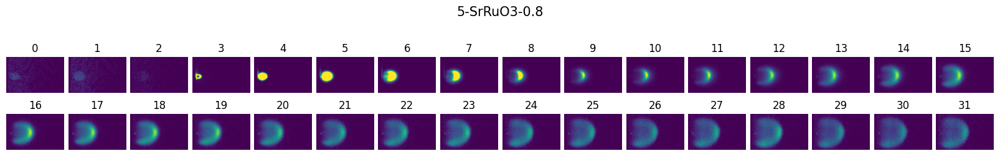

100%|██████████| 6/6 [00:00<00:00,  7.31it/s]


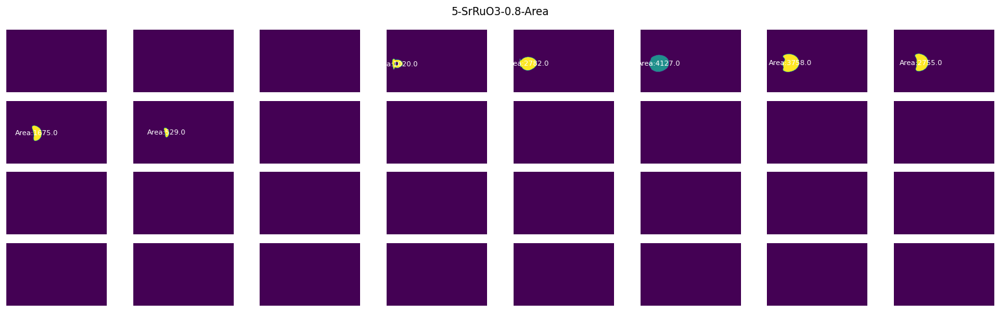

100%|██████████| 6/6 [00:00<00:00,  7.51it/s]


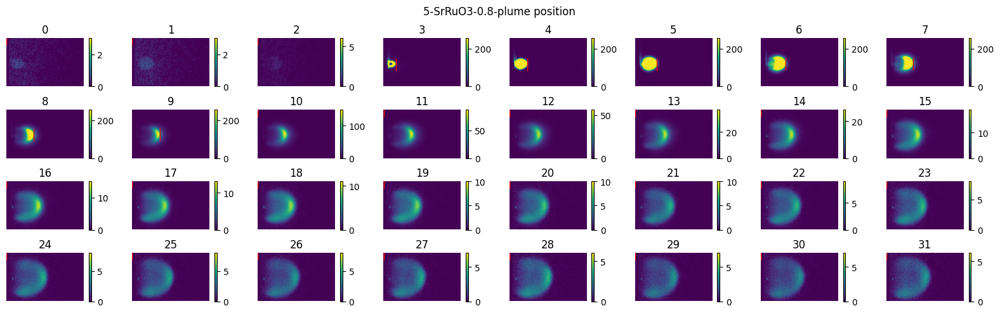

In [5]:
for file in glob.glob('D:/pld_plumes/SRO_STO_Drexel/SRO_Mapping/*.h5'):
    plume_ds = plume_dataset(file_path=file, group_name='PLD_Plumes')
    datasets = plume_ds.dataset_names()
    pressure = file.split('/')[-1].split('_')[-3][:-5]    # print(pressure)
    for dataset in datasets:
        if dataset == '1-SrRuO3_Pre':
            continue
        fluence = dataset.split('-')[-1]
        print(file, pressure, fluence)
        plumes = plume_ds.load_plumes(dataset)
        # visualize parameters

        # align parameters
        coords_standard = np.load('./standard_coords.npy')
        align_parms = {'align':False, 'coords':coords, 'coords_standard':coords_standard}

        # metric parameters
        start_position = np.round(np.mean(coords[:2], axis=0)).astype(np.int32) # start position of plume  (x, y)
        position_range = np.min(coords[:,0]), np.max(coords[:,0]) # x position range

        viz_parms = {'viz':False, 'index':0, 'viz_index':list(np.arange(0, 32, 1)), 'plume_name': dataset}
        metric_parms = {'time_interval':500e-9, 'start_position':start_position, 'position_range':position_range, 'threshold':'flexible', 'rename_dataset':True}
        df_flex = analyze_function(plumes, viz_parms, metric_parms, align_parms={'align':False, 'coords':coords, 'coords_standard':coords_standard})

        viz_parms = {'viz':False, 'index':0, 'viz_index':list(np.arange(0, 32, 1)), 'plume_name': dataset}
        metric_parms = {'time_interval':500e-9, 'start_position':start_position, 'position_range':position_range, 'threshold':5, 'rename_dataset':True}
        df_5 = analyze_function(plumes, viz_parms, metric_parms, align_parms={'align':True, 'coords':coords, 'coords_standard':coords_standard})

        viz_parms = {'viz':True, 'index':0, 'viz_index':list(np.arange(0, 32, 1)), 'plume_name': dataset}
        metric_parms = {'time_interval':500e-9, 'start_position':start_position, 'position_range':position_range, 'threshold':200, 'rename_dataset':True}
        df_200 = analyze_function(plumes, viz_parms, metric_parms, align_parms={'align':True, 'coords':coords, 'coords_standard':coords_standard})

        df_all = pd.concat([df_5, df_200, df_flex])
        df_all.to_csv(f'../../../../datasets/SRO_plume_metrics/SRO_condition_mapping_metrics-P{pressure}_F{fluence}.csv')

### merge all csv file and combine the growth conditions

In [12]:
import re
for file in glob.glob('../../../../datasets/SRO_plume_metrics/SRO_condition_mapping*.csv'):
    filename = file.split('\\')[-1]
    
    match = re.search(r'P(\d+)_F(\d+(?:\.\d+)?)', filename)
    growth = filename.split('-.')
    pressure = filename.split('_')
    fluence = filename.split('_')
    
    growth = match.group(0)  # P125_F0.8
    pressure = int(match.group(1))  # 125
    fluence = float(match.group(2))  # 0.8
    print(file, growth, pressure, fluence)

../../../../datasets/SRO_plume_metrics\SRO_condition_mapping_metrics-P100_F0.8.csv P100_F0.8 100 0.8
../../../../datasets/SRO_plume_metrics\SRO_condition_mapping_metrics-P100_F1.2.csv P100_F1.2 100 1.2
../../../../datasets/SRO_plume_metrics\SRO_condition_mapping_metrics-P100_F1.6.csv P100_F1.6 100 1.6
../../../../datasets/SRO_plume_metrics\SRO_condition_mapping_metrics-P100_F2.2.csv P100_F2.2 100 2.2
../../../../datasets/SRO_plume_metrics\SRO_condition_mapping_metrics-P100_F2.csv P100_F2 100 2.0
../../../../datasets/SRO_plume_metrics\SRO_condition_mapping_metrics-P125_F0.8.csv P125_F0.8 125 0.8
../../../../datasets/SRO_plume_metrics\SRO_condition_mapping_metrics-P125_F1.2.csv P125_F1.2 125 1.2
../../../../datasets/SRO_plume_metrics\SRO_condition_mapping_metrics-P125_F1.6.csv P125_F1.6 125 1.6
../../../../datasets/SRO_plume_metrics\SRO_condition_mapping_metrics-P125_F2.2.csv P125_F2.2 125 2.2
../../../../datasets/SRO_plume_metrics\SRO_condition_mapping_metrics-P125_F2.csv P125_F2 125 2.

In [17]:
df_list = []

for file in glob.glob('../../../../datasets/SRO_plume_metrics/SRO_condition_mapping*.csv'):
    filename = file.split('\\')[-1]
    
    match = re.search(r'P(\d+)_F(\d+(?:\.\d+)?)', filename)
    growth = filename.split('-.')
    pressure = filename.split('_')
    fluence = filename.split('_')
    
    growth = match.group(0)  # P125_F0.8
    pressure = int(match.group(1))  # 125
    fluence = float(match.group(2))  # 0.8
    print(file, growth, pressure, fluence)
    
    df = pd.read_csv(file)
    # print(df.columns)
    # df = df.drop('Growth', axis=1)
    df['Growth'] = growth
    df['Pressure (mTorr)'] = pressure
    df['Fluence (J/cm2)'] = fluence
    
    df_list.append(df)

../../../../datasets/SRO_plume_metrics\SRO_condition_mapping_metrics-P100_F0.8.csv P100_F0.8 100 0.8
../../../../datasets/SRO_plume_metrics\SRO_condition_mapping_metrics-P100_F1.2.csv P100_F1.2 100 1.2
../../../../datasets/SRO_plume_metrics\SRO_condition_mapping_metrics-P100_F1.6.csv P100_F1.6 100 1.6
../../../../datasets/SRO_plume_metrics\SRO_condition_mapping_metrics-P100_F2.2.csv P100_F2.2 100 2.2
../../../../datasets/SRO_plume_metrics\SRO_condition_mapping_metrics-P100_F2.csv P100_F2 100 2.0
../../../../datasets/SRO_plume_metrics\SRO_condition_mapping_metrics-P125_F0.8.csv P125_F0.8 125 0.8
../../../../datasets/SRO_plume_metrics\SRO_condition_mapping_metrics-P125_F1.2.csv P125_F1.2 125 1.2
../../../../datasets/SRO_plume_metrics\SRO_condition_mapping_metrics-P125_F1.6.csv P125_F1.6 125 1.6
../../../../datasets/SRO_plume_metrics\SRO_condition_mapping_metrics-P125_F2.2.csv P125_F2.2 125 2.2
../../../../datasets/SRO_plume_metrics\SRO_condition_mapping_metrics-P125_F2.csv P125_F2 125 2.

In [19]:
df_all = pd.concat(df_list)
df_all.to_csv('../../../../datasets/SRO_plume_metrics/SRO_condition_mapping_metrics-all.csv')
df_all.sample(5)

,plume_index,time_index,Distance,Velocity,Area,Threshold,Growth,Pressure (mTorr),Fluence (J/cm2)
677,5,37,369,0.0,10573.0,5,P200_F2,200,2.0
1325,4,45,219,0.0,0.0,200,P125_F2.2,125,2.2
259,2,3,288,390000000.0,39056.0,5,P200_F2.2,200,2.2
763,5,123,369,0.0,27.0,5,P125_F2.2,125,2.2
1526,5,118,189,0.0,0.0,200,P100_F1.6,100,1.6


### plot

In [21]:
# df_all = pd.read_csv('../../../../datasets/SRO_plume_metrics/SRO_condition_mapping_metrics-all.csv')
print(df_all['Threshold'].unique())

['5' '200' 'flexible']


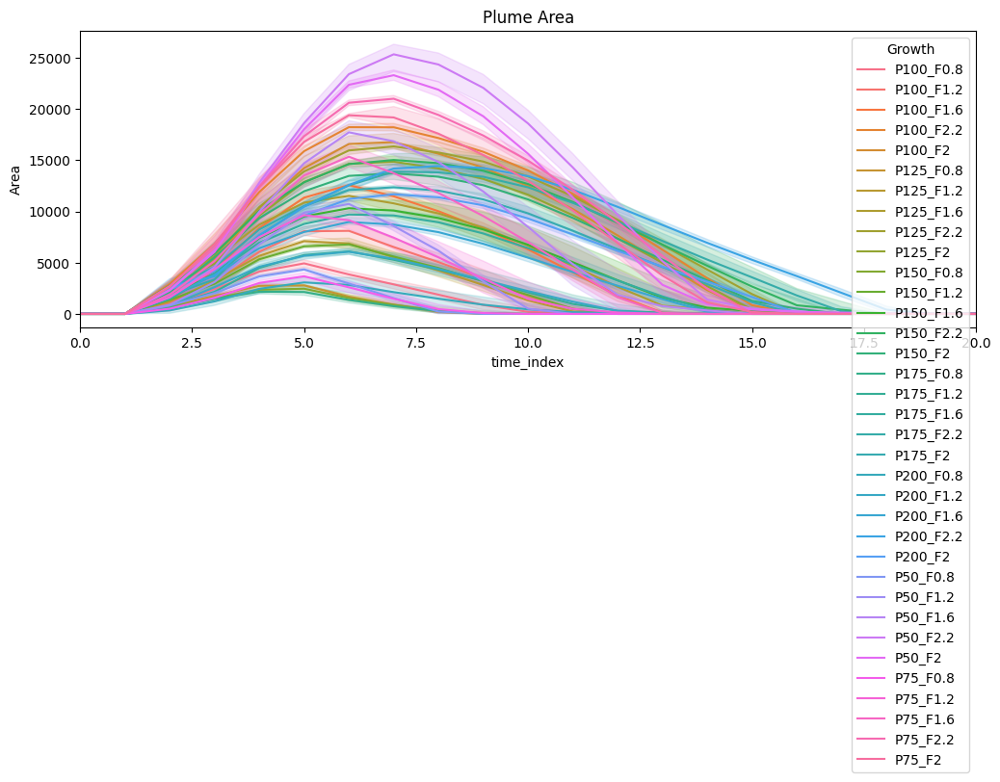

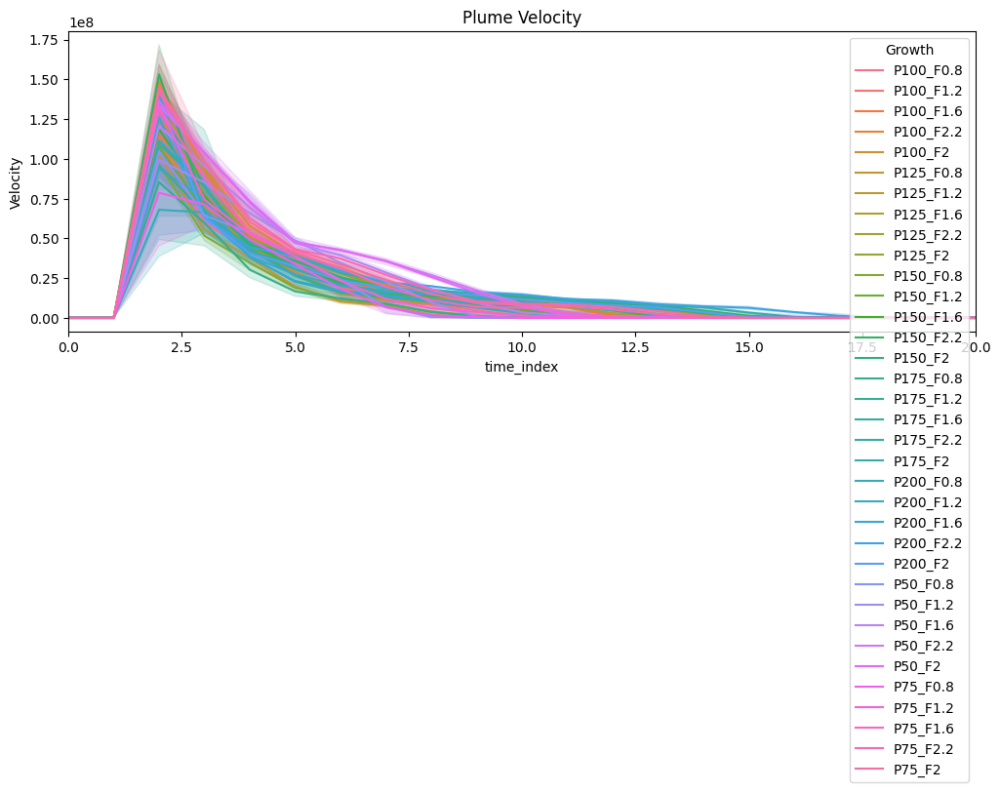

In [27]:
df_200 = df_all[df_all['Threshold']=='200']

fig, ax = plt.subplots(figsize=(12, 4))
lineplot = sns.lineplot(x="time_index", y="Area", hue="Growth", data=df_200)
plt.title('Plume Area')
plt.xlim(0, 20)
plt.show()

fig, ax = plt.subplots(figsize=(12, 4))
lineplot = sns.lineplot(x="time_index", y="Velocity", hue="Growth", data=df_200)
plt.title('Plume Velocity')
plt.xlim(0, 20)
plt.show()

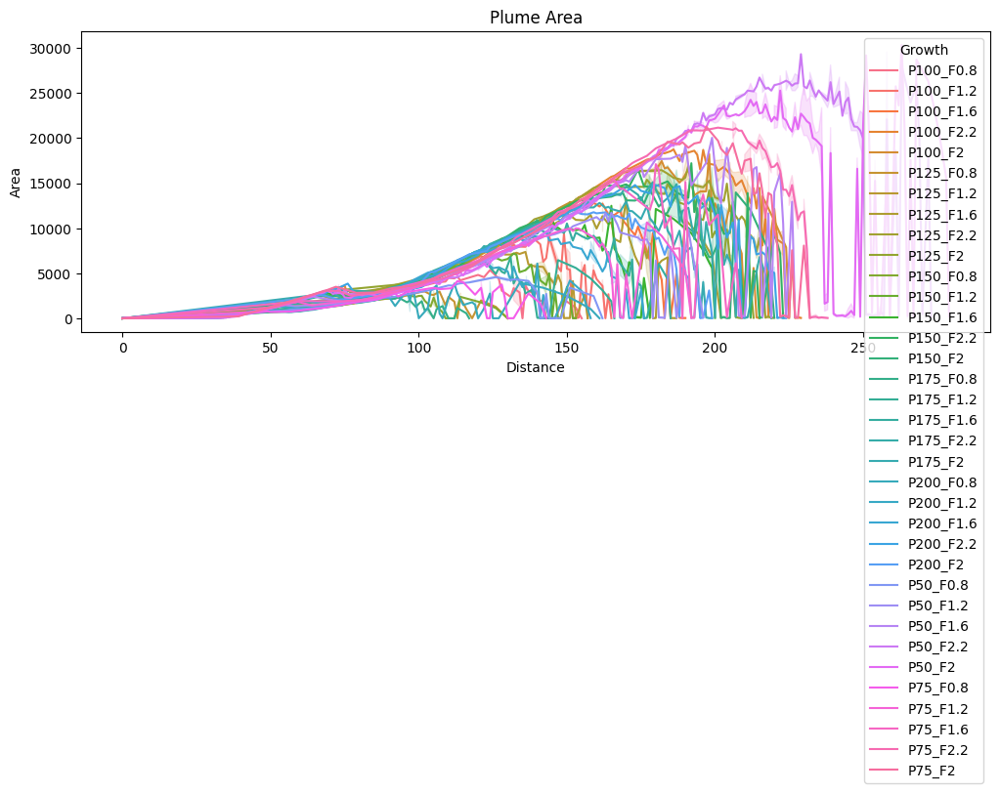

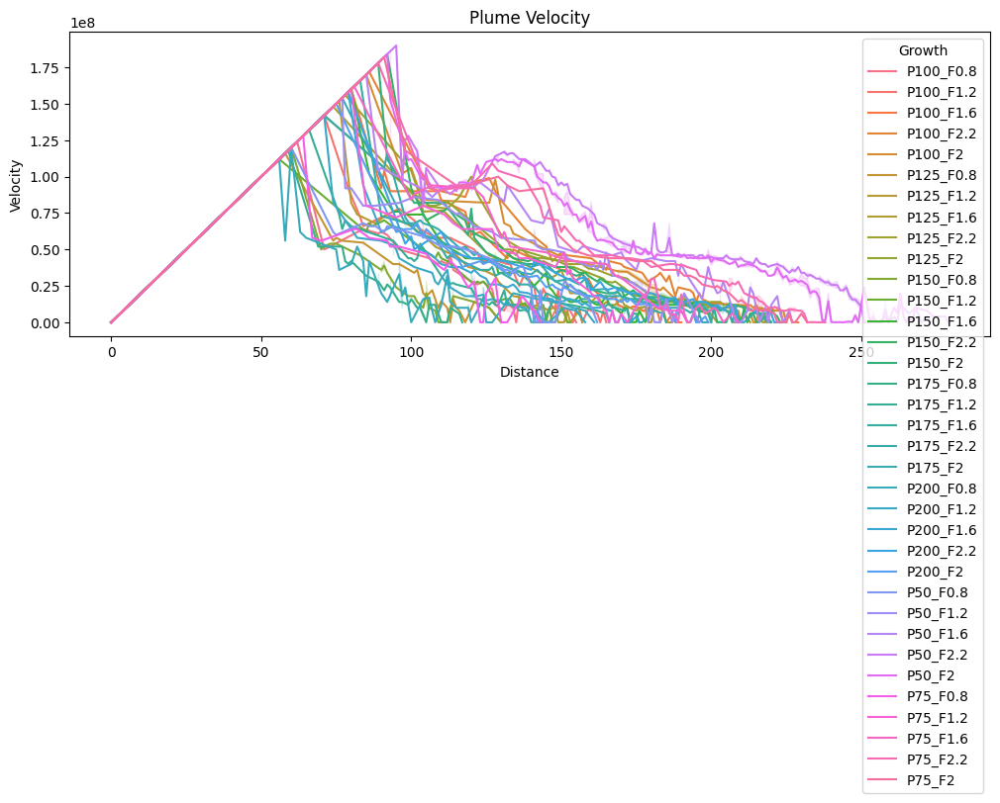

In [26]:
fig, ax = plt.subplots(figsize=(12, 4))
lineplot = sns.lineplot(x="Distance", y="Area", hue="Growth", data=df_200)
plt.title('Plume Area')
plt.show()

fig, ax = plt.subplots(figsize=(12, 4))
lineplot = sns.lineplot(x="Distance", y="Velocity", hue="Growth", data=df_200)
plt.title('Plume Velocity')
plt.show()